# Project Overview

This project focuses on crowd counting using deep learning techniques. The workflow includes:

- **Data Preparation:** Loading and preprocessing image data and corresponding annotations, generating density maps for crowd counting.
- **Exploratory Data Analysis (EDA):** Visualizing sample images and their density maps to understand the dataset.
- **Model Development:** Implementing and training multiple models for crowd counting:
    - VGG-based CSRNet with decoder
    - Multi-Column Convolutional Neural Network (MCNN)
    - ResNet101-based model
- **Evaluation:** Assessing model performance using Mean Squared Error (MSE) and Grid Average Mean absolute Error (GAME) metrics.
- **Visualization:** Comparing ground truth and predicted density maps for test images.
- **Model Saving:** Saving trained models for future inference.

The notebook leverages TensorFlow, Keras, OpenCV, and Matplotlib for model building, data processing, and visualization.

## Import Library, Dataset & Set Dependencies

In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt 
import PIL
import numpy as np
import cv2
import re
import ast

import tensorflow as tf
from tensorflow.keras.utils import Sequence
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers, models, applications, Input
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import Callback
from sklearn.model_selection import train_test_split

In [107]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [108]:
import tensorflow as tf
print(tf.__version__)

2.10.0


In [5]:
df = pd.read_csv("output.csv")
df.head()

,count,annotations,image_name
0,29,[[126.77986348 60.70477816]\n [116.95051195 ...,seq_000001.jpg
1,30,[[ 57.1552901 199.13481229]\n [ 87.46245734 2...,seq_000002.jpg
2,35,[[118.73899371 43.77044025]\n [134.83962264 ...,seq_000003.jpg
3,31,[[140.87735849 44.77672956]\n [151.94654088 ...,seq_000004.jpg
4,26,[[123.77044025 51.82075472]\n [145.90880503 ...,seq_000005.jpg


## Image preprocessing & EDA

### Explanation of `get_coords` Function

The `get_coords` function is used to convert a string representation of coordinates into a NumPy array of shape (N, 2), where N is the number of coordinate points. It performs the following steps:

- Uses a regular expression to remove square brackets and newline characters from the input string.
- Converts the cleaned string into a 1D NumPy array of floats using `np.fromstring`.
- Reshapes the array into a 2D array with two columns, representing x and y coordinates for each point.

This function is useful for parsing annotation data stored as strings into a structured numerical format for further processing.

In [6]:
def get_coords(coords):
    return np.fromstring(re.sub(r'[\[\]\n]+', ' ', coords), sep=' ').reshape(-1, 2)

df['annotations'] = df['annotations'].apply(get_coords)

In [11]:
path = "D:\SEM-4\Deep Learning\GSLC 2"

image_path = os.path.join(path, 'frames')

In [12]:
full_path = []
for fname in sorted(os.listdir(image_path)):
    if fname.lower().endswith('.jpg'):
        full_path.append(os.path.join(image_path, fname))

The `plot_image` function visualizes an image along with its annotated points. It performs the following steps:

- Reads the image from the specified file path using OpenCV and converts it from BGR to RGB format for correct color display.
- Retrieves the image dimensions (height and width).
- Prints the image filename, its dimensions, and the number of annotation points.
- Plots the annotation points as red dots on top of the image using Matplotlib's `scatter` function.
- Displays the image with the annotation points and hides the axis for a cleaner visualization.

This function is useful for visually verifying the correctness of annotation data on the corresponding images.

Gambar: seq_000001.jpg, Ukuran: 640 x 480, Titik: 29


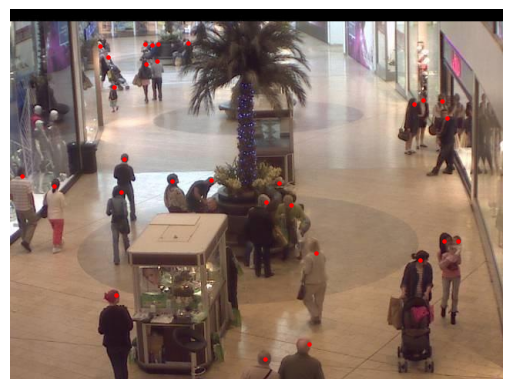

Gambar: seq_000002.jpg, Ukuran: 640 x 480, Titik: 30


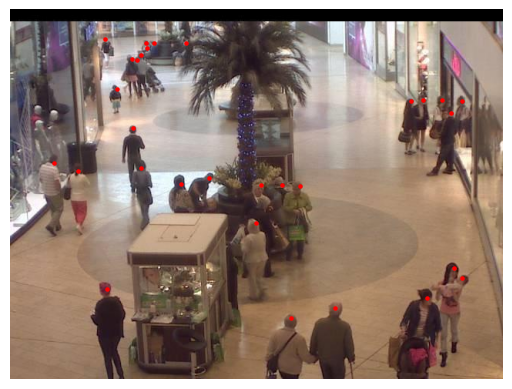

Gambar: seq_000003.jpg, Ukuran: 640 x 480, Titik: 35


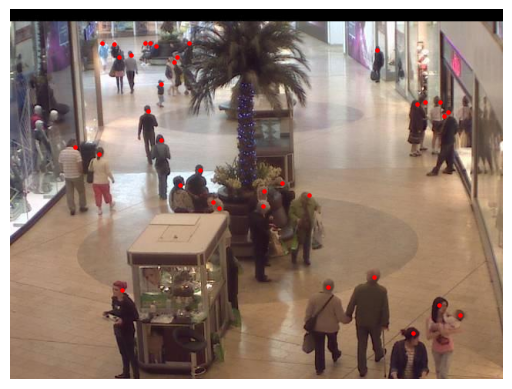

In [13]:
def plot_image(path, annotation):
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # defaultnya cv2 bacanya bgr jadi convert dlu ke rgb

    h, w, _ = img.shape
    print(f"Gambar: {os.path.basename(path)}, Ukuran: {w} x {h}, Titik: {len(annotation)}")

    plt.scatter(annotation[:, 0], annotation[:, 1], color='red', s=5)
    plt.imshow(img)
    plt.axis("off")
    plt.show()

for i in range(3):
    plot_image(full_path[i], df['annotations'][i])

The `generate_density_map` function creates a density map for a given image shape and a set of annotated points (e.g., crowd locations). It works as follows:

- Initializes a zero matrix with the same shape as the target image.
- For each point in the annotation, it generates a 2D Gaussian kernel centered at that point.
- The Gaussian kernel is added to the density map at the corresponding location, taking care of image boundaries.
- The result is a density map where each annotated point is represented as a smooth peak, which can be used for crowd counting by summing the map values.

This function is essential for converting point annotations into continuous density maps suitable for training deep learning models in crowd counting tasks.

In [14]:
def generate_density_map(img_shape, points, kernel_size=11, sigma=3):
    density = np.zeros(img_shape, dtype=np.float32)
    H, W = img_shape
    k = cv2.getGaussianKernel(kernel_size, sigma)
    kernel = k @ k.T

    for point in points:
        x = min(int(point[0]), W - 1)
        y = min(int(point[1]), H - 1)

        x1 = max(0, x - kernel_size // 2)
        y1 = max(0, y - kernel_size // 2)
        x2 = min(W, x + kernel_size // 2 + 1)
        y2 = min(H, y + kernel_size // 2 + 1)

        kx1 = kernel_size // 2 - (x - x1)
        ky1 = kernel_size // 2 - (y - y1)
        kx2 = kernel_size // 2 + (x2 - x)
        ky2 = kernel_size // 2 + (y2 - y)

        density[y1:y2, x1:x2] += kernel[ky1:ky2, kx1:kx2]
    
    return density

The `CrowdDataset` class is a custom data generator that inherits from Keras' `Sequence` class. It is designed to efficiently load, preprocess, and batch image data along with their corresponding density maps for crowd counting tasks.

### Explanation:
- **Initialization (`__init__`)**: Takes a DataFrame containing image names and annotations, sets the target image size, batch size, and the image folder path.
- **Length (`__len__`)**: Returns the number of batches per epoch.
- **Get Item (`__getitem__`)**: For each batch:
    - Loads and resizes images.
    - Normalizes pixel values.
    - Scales annotation points to match the resized image.
    - Generates density maps using the annotation points.
    - Returns batches of images and their corresponding density maps.

### Why We Need `CrowdDataset`:
- **Efficient Data Loading**: Handles large datasets by loading data in batches, reducing memory usage.
- **On-the-fly Preprocessing**: Applies resizing, normalization, and density map generation during training, ensuring data is always prepared correctly.
- **Integration with Keras**: Works seamlessly with Keras' `fit` method for model training, supporting features like multiprocessing and shuffling.
- **Consistency**: Ensures that images and their annotations are always paired and processed in the same way, which is crucial for supervised learning tasks like crowd counting.bm


In [23]:
class CrowdDataset(Sequence):
    def __init__(self, df, target_size=(224, 224), batch_size=4):
        self.df = df
        self.target_size = target_size
        self.batch_size = batch_size
        self.image_folder = "D:/SEM-4/Deep Learning/GSLC 2/frames"

    def __len__(self):
        return int(np.ceil(len(self.df) / self.batch_size))

    def __getitem__(self, idx):
        batch_df = self.df.iloc[idx * self.batch_size: (idx + 1) * self.batch_size]

        imgs, maps = [], []

        for _, row in batch_df.iterrows():
            full_path = os.path.join(self.image_folder, row["image_name"])
            img = cv2.imread(full_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            h0, w0 = img.shape[:2]
            img_resized = cv2.resize(img, self.target_size)
            img_resized = img_resized / 255.0

            # Resize koordinat titik ke skala baru
            x_scale, y_scale = self.target_size[0] / w0, self.target_size[1] / h0
            points = row["annotations"] * np.array([x_scale, y_scale])

            density = generate_density_map(self.target_size[::-1], points)

            imgs.append(img_resized)
            maps.append(density[..., np.newaxis])  # tambahkan channel

        return np.array(imgs, dtype=np.float32), np.array(maps, dtype=np.float32)

## Data splitting

In [24]:
train_df, test_df = train_test_split(df, test_size=0.2, random_state=1)
train_df, valid_df = train_test_split(train_df, test_size = 0.125, random_state=1)

train_gen = CrowdDataset(train_df)
valid_gen = CrowdDataset(valid_df)
test_gen = CrowdDataset(test_df)

## Image & density map preview for each: training, testing, validation data

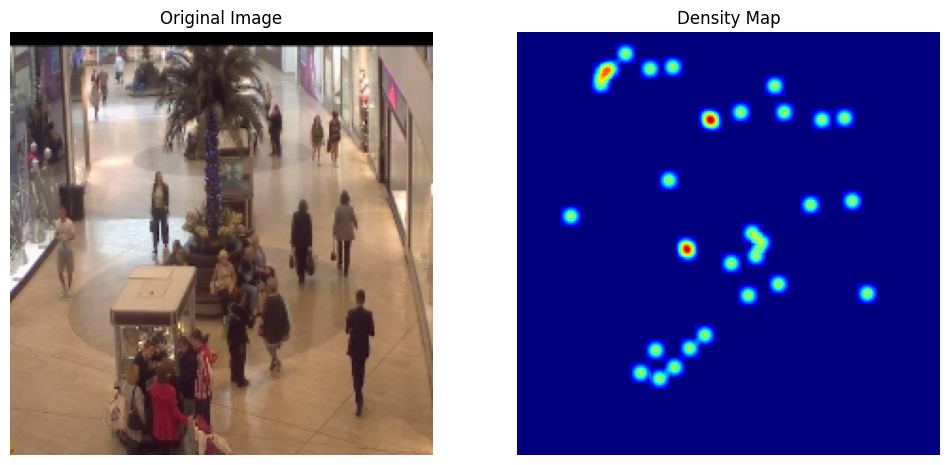

Min, Max values in density map: 0.0 0.036239956


In [25]:
X_batch, y_batch = train_gen[0]

image = X_batch[0]
density_map = y_batch[0].squeeze()

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(image)
axes[0].set_title('Original Image')
axes[0].axis('off')

axes[1].imshow(density_map, cmap='jet')
axes[1].set_title('Density Map')
axes[1].axis('off')

plt.show()

print("Min, Max values in density map:", np.min(density_map), np.max(density_map))

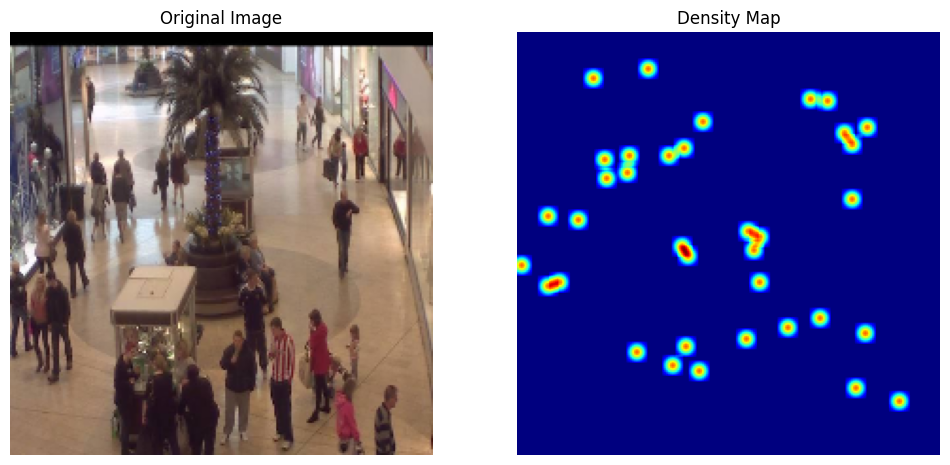

Min, Max values in density map: 0.0 0.025172804


In [26]:
X_batch, y_batch = test_gen[0]

image = X_batch[0]
density_map = y_batch[0].squeeze()

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(image)
axes[0].set_title('Original Image')
axes[0].axis('off')

axes[1].imshow(density_map, cmap='jet')
axes[1].set_title('Density Map')
axes[1].axis('off')

plt.show()

print("Min, Max values in density map:", np.min(density_map), np.max(density_map))

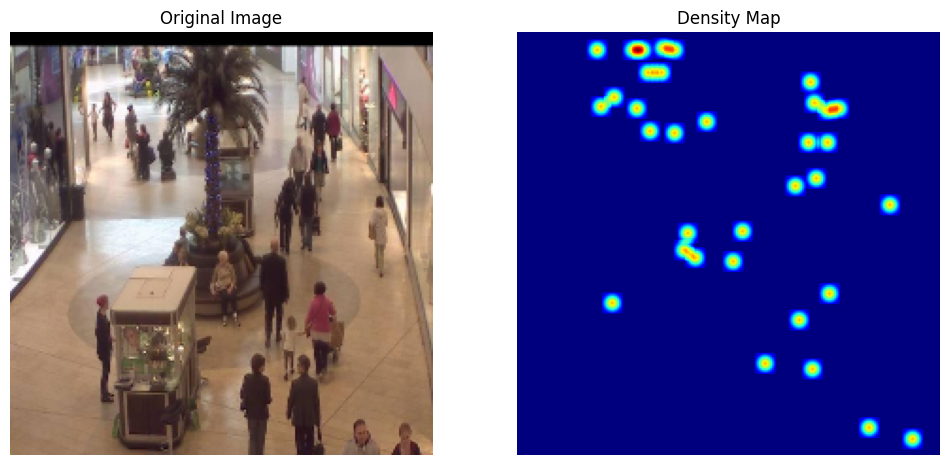

Min, Max values in density map: 0.0 0.028496364


In [27]:
X_batch, y_batch = valid_gen[0]

image = X_batch[0]
density_map = y_batch[0].squeeze()

# Plotting
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(image)
axes[0].set_title('Original Image')
axes[0].axis('off')

axes[1].imshow(density_map, cmap='jet')
axes[1].set_title('Density Map')
axes[1].axis('off')

plt.show()

print("Min, Max values in density map:", np.min(density_map), np.max(density_map))

## Callback function implementation

The `PlotPredictionCallback` class is a custom Keras callback designed to visualize model predictions during training. It inherits from `tf.keras.callbacks.Callback` and is used to monitor the model's progress by plotting the input image, ground truth density map, and the predicted density map at the end of specified training epochs.

**Purpose:**
- To provide visual feedback on how well the model is learning to predict density maps for crowd counting.
- To help identify issues such as underfitting, overfitting, or incorrect predictions during training.

**How it works:**
- The class is initialized with a dataset (data generator), an index specifying which batch to visualize, and an interval (number of epochs between plots).
- At the end of each epoch, it checks if the current epoch matches the specified interval.
- If so, it retrieves a batch of images and ground truth maps from the dataset, uses the current model to predict the density map, and then plots:
    - The input image.
    - The ground truth density map.
    - The predicted density map.
- This visualization helps track the model's learning progress in real time.

This callback is especially useful for tasks like crowd counting, where visual inspection of predicted density maps provides valuable insights into model performance beyond numerical metrics.

In [120]:
class PlotPredictionCallback(Callback):
    def __init__(self, dataset, index=0, interval=100):
        super().__init__()
        self.dataset = dataset
        self.index = index  
        self.interval = interval

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.interval == 0:
            img_batch, gt_batch = self.dataset[self.index]

            img = img_batch[0][np.newaxis, ...]  # tambah dimensi batch
            gt = gt_batch[0][..., 0]  # ground truth-nya (hilangkan channel)
    
            pred = self.model.predict(img)[0, ..., 0]  # hilangkan batch & channel

            # Plot hasilnya
            fig, axs = plt.subplots(1, 3, figsize=(12, 4))
            axs[0].imshow(img[0])
            axs[0].set_title("Input Image")
            axs[1].imshow(gt, cmap='jet')
            axs[1].set_title("Ground Truth")
            axs[2].imshow(pred, cmap='jet')
            axs[2].set_title(f"Prediction - Epoch {epoch+1}")
            for ax in axs:
                ax.axis('off')
            plt.tight_layout()
            plt.show()


check_point = EarlyStopping(
    monitor = 'loss',
    mode = 'min',
    patience = 20
)

plot_callback = PlotPredictionCallback(train_gen, index=0)

## First Model (CSRnet + Decoder)

#### The first model we used is CSRNet combined with a decoder. We chose CSRNet because it uses dilated convolution layers, which help expand the receptive field—allowing the model to “see” a wider area of the image without reducing the resolution. After extracting features using dilated convolution, we added a decoder to restore the output size back to match the input size. We used a combination of upsampling and Conv2DTranspose, so the decoder doesn’t just enlarge the feature map but also helps the model relearn and refine the density map to make it more accurate and realistic.

In [121]:
def CSRNet(input_shape=(224, 224, 3)):
    input_img = layers.Input(shape=input_shape)

    vgg = applications.VGG16(include_top=False, weights='imagenet', input_tensor=input_img)
    for layer in vgg.layers:
        layer.trainable = False

    x = vgg.output
    x = layers.Conv2D(512, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(512, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(512, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(256, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(128, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(64, 3, dilation_rate=2, padding='same', activation='relu')(x)
    x = layers.Conv2D(1, 1, padding='same')(x) # 7



    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same', activation='relu')(x)  
    x = layers.UpSampling2D(size=(2, 2), interpolation='bilinear')(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same', activation='relu')(x)   
    x = layers.UpSampling2D(size=(2, 2), interpolation='bilinear')(x)
    x = layers.Conv2DTranspose(1, 3, strides=2, padding='same')(x)                        


    return models.Model(inputs=input_img, outputs=x)

In [122]:
model = CSRNet()
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mse')

model.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

Epoch 1/2000
350/350 [==============================] - 8s 21ms/step - loss: 7.9005e-06 - val_loss: 7.3717e-06
Epoch 2/2000
350/350 [==============================] - 6s 18ms/step - loss: 7.3666e-06 - val_loss: 7.0661e-06
Epoch 3/2000
350/350 [==============================] - 6s 18ms/step - loss: 7.1068e-06 - val_loss: 6.8617e-06
Epoch 4/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.9121e-06 - val_loss: 6.7587e-06
Epoch 5/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.7542e-06 - val_loss: 6.5919e-06
Epoch 6/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.6260e-06 - val_loss: 6.5701e-06
Epoch 7/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.4981e-06 - val_loss: 6.4327e-06
Epoch 8/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.3775e-06 - val_loss: 6.2593e-06
Epoch 9/2000
350/350 [==============================] - 6s 17ms/step - loss: 6.2730e-06 - val_loss: 6.1930e-06
E

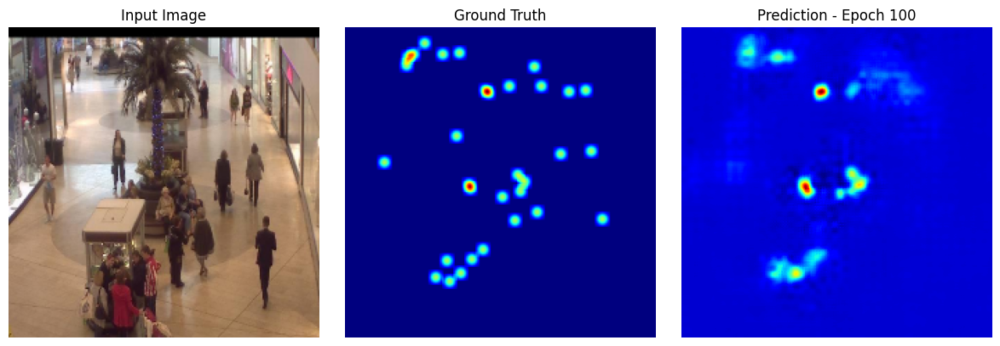

350/350 [==============================] - 10s 29ms/step - loss: 4.6409e-06 - val_loss: 5.1557e-06
Epoch 101/2000
350/350 [==============================] - 7s 20ms/step - loss: 4.6381e-06 - val_loss: 5.2323e-06
Epoch 102/2000
350/350 [==============================] - 7s 20ms/step - loss: 4.6293e-06 - val_loss: 5.2200e-06
Epoch 103/2000
350/350 [==============================] - 7s 19ms/step - loss: 4.6256e-06 - val_loss: 5.2317e-06
Epoch 104/2000
350/350 [==============================] - 7s 19ms/step - loss: 4.6221e-06 - val_loss: 5.1845e-06
Epoch 105/2000
350/350 [==============================] - 6s 19ms/step - loss: 4.6028e-06 - val_loss: 5.1874e-06
Epoch 106/2000
350/350 [==============================] - 6s 18ms/step - loss: 4.6073e-06 - val_loss: 5.3125e-06
Epoch 107/2000
350/350 [==============================] - 6s 18ms/step - loss: 4.6114e-06 - val_loss: 5.1650e-06
Epoch 108/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.5989e-06 - val_loss: 5.1990e-

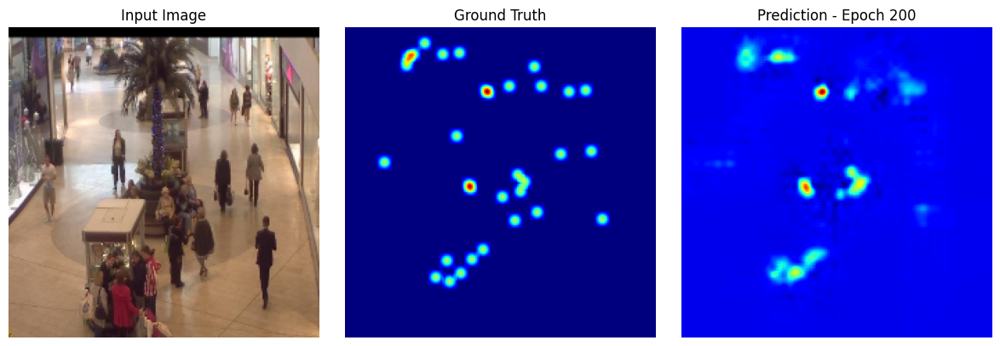

350/350 [==============================] - 6s 17ms/step - loss: 4.2207e-06 - val_loss: 5.3265e-06
Epoch 201/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2212e-06 - val_loss: 5.4101e-06
Epoch 202/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2387e-06 - val_loss: 5.3514e-06
Epoch 203/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2331e-06 - val_loss: 5.2997e-06
Epoch 204/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2141e-06 - val_loss: 5.3080e-06
Epoch 205/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2121e-06 - val_loss: 5.2491e-06
Epoch 206/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2196e-06 - val_loss: 5.3626e-06
Epoch 207/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2079e-06 - val_loss: 5.3898e-06
Epoch 208/2000
350/350 [==============================] - 6s 17ms/step - loss: 4.2038e-06 - val_loss: 5.3084e-0

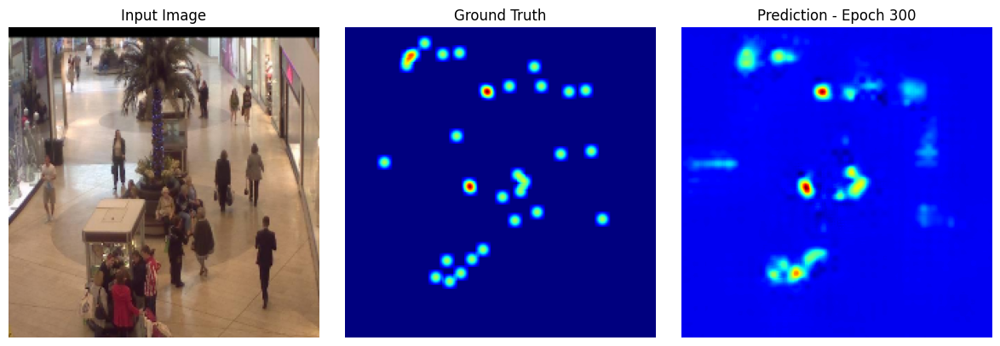

350/350 [==============================] - 7s 20ms/step - loss: 4.0004e-06 - val_loss: 5.8000e-06
Epoch 301/2000
350/350 [==============================] - 7s 19ms/step - loss: 4.0061e-06 - val_loss: 5.5054e-06
Epoch 302/2000
350/350 [==============================] - 7s 19ms/step - loss: 4.0041e-06 - val_loss: 5.4882e-06
Epoch 303/2000
350/350 [==============================] - 7s 19ms/step - loss: 3.9965e-06 - val_loss: 5.5713e-06
Epoch 304/2000
350/350 [==============================] - 7s 19ms/step - loss: 4.0009e-06 - val_loss: 5.6365e-06
Epoch 305/2000
350/350 [==============================] - 6s 18ms/step - loss: 4.0037e-06 - val_loss: 5.4119e-06
Epoch 306/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.9961e-06 - val_loss: 5.4805e-06
Epoch 307/2000
350/350 [==============================] - 6s 18ms/step - loss: 3.9811e-06 - val_loss: 5.4774e-06
Epoch 308/2000
350/350 [==============================] - 7s 19ms/step - loss: 3.9850e-06 - val_loss: 5.5727e-0

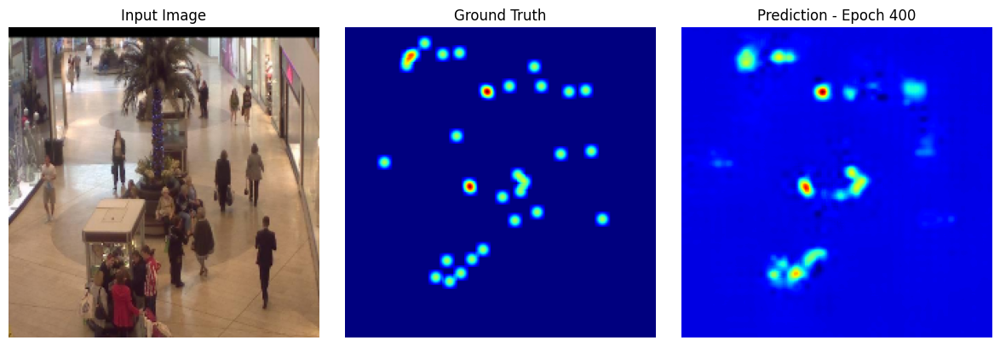

350/350 [==============================] - 7s 20ms/step - loss: 3.8568e-06 - val_loss: 5.5087e-06
Epoch 401/2000
350/350 [==============================] - 7s 20ms/step - loss: 3.8555e-06 - val_loss: 5.6660e-06
Epoch 402/2000
350/350 [==============================] - 7s 20ms/step - loss: 3.8465e-06 - val_loss: 5.6477e-06
Epoch 403/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.8506e-06 - val_loss: 5.6087e-06
Epoch 404/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.8534e-06 - val_loss: 5.5818e-06
Epoch 405/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.8477e-06 - val_loss: 5.6055e-06
Epoch 406/2000
350/350 [==============================] - 6s 18ms/step - loss: 3.8465e-06 - val_loss: 5.8085e-06
Epoch 407/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.8498e-06 - val_loss: 5.4808e-06
Epoch 408/2000
350/350 [==============================] - 6s 18ms/step - loss: 3.8639e-06 - val_loss: 5.6517e-0

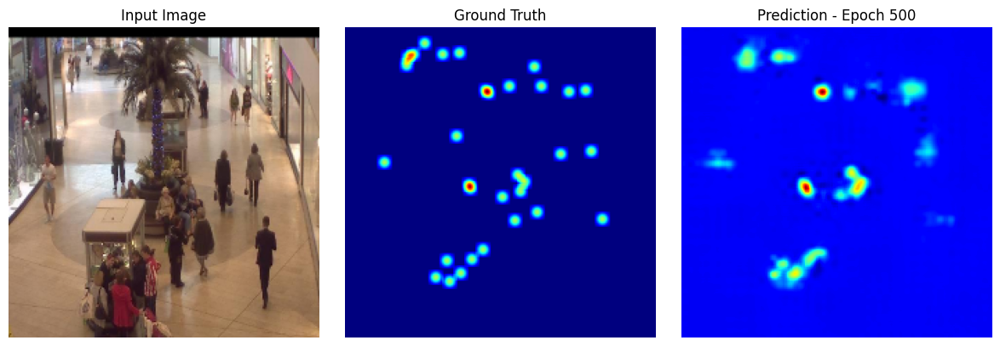

350/350 [==============================] - 6s 18ms/step - loss: 3.7510e-06 - val_loss: 5.7286e-06
Epoch 501/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.7475e-06 - val_loss: 5.8022e-06
Epoch 502/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.7483e-06 - val_loss: 5.8550e-06
Epoch 503/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.7437e-06 - val_loss: 5.6728e-06
Epoch 504/2000
350/350 [==============================] - 8s 22ms/step - loss: 3.7710e-06 - val_loss: 5.6055e-06
Epoch 505/2000
350/350 [==============================] - 7s 19ms/step - loss: 3.7570e-06 - val_loss: 5.6649e-06
Epoch 506/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.7485e-06 - val_loss: 5.8151e-06
Epoch 507/2000
350/350 [==============================] - 6s 17ms/step - loss: 3.7410e-06 - val_loss: 6.0433e-06
Epoch 508/2000
350/350 [==============================] - 6s 18ms/step - loss: 3.7387e-06 - val_loss: 5.7650e-0

In [123]:
history = model.fit(train_gen, validation_data = valid_gen ,epochs=2000, callbacks=[check_point, plot_callback])

In [124]:
for i in range(len(test_gen)):
    print(i)
    X_batch, Y_batch = test_gen[i]
    Y_pred = model.predict(X_batch)

0
1/1 [==============================] - 0s 14ms/step
1
1/1 [==============================] - 0s 12ms/step
2
1/1 [==============================] - 0s 10ms/step
3
1/1 [==============================] - 0s 11ms/step
4
1/1 [==============================] - 0s 14ms/step
5
1/1 [==============================] - 0s 12ms/step
6
1/1 [==============================] - 0s 11ms/step
7
1/1 [==============================] - 0s 12ms/step
8
1/1 [==============================] - 0s 13ms/step
9
1/1 [==============================] - 0s 11ms/step
10
1/1 [==============================] - 0s 12ms/step
11
1/1 [==============================] - 0s 12ms/step
12
1/1 [==============================] - 0s 13ms/step
13
1/1 [==============================] - 0s 12ms/step
14
1/1 [==============================] - 0s 12ms/step
15
1/1 [==============================] - 0s 13ms/step
16
1/1 [==============================] - 0s 12ms/step
17
1/1 [==============================] - 0s 12ms/step
18
1/1 [============

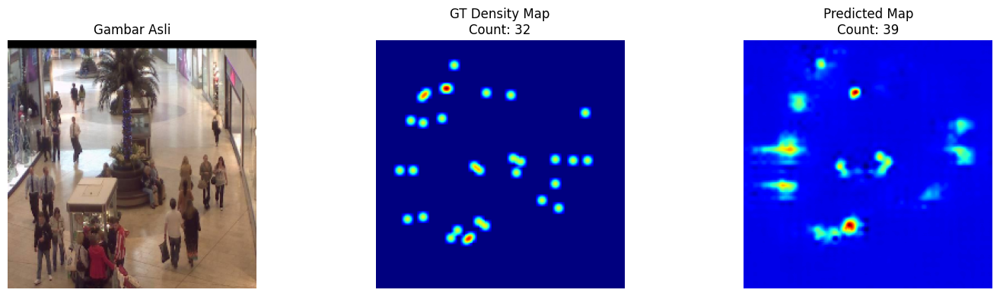

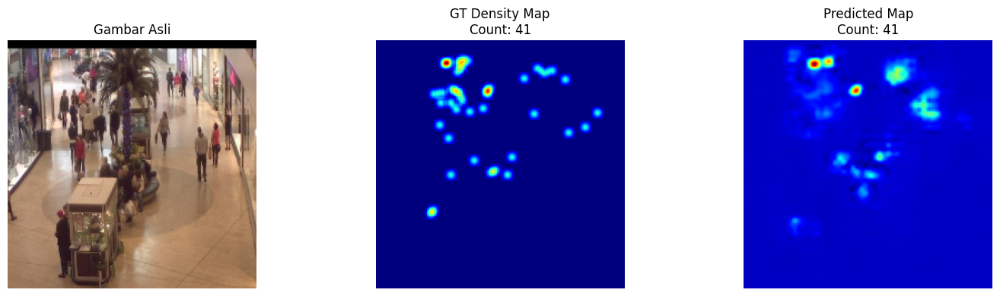

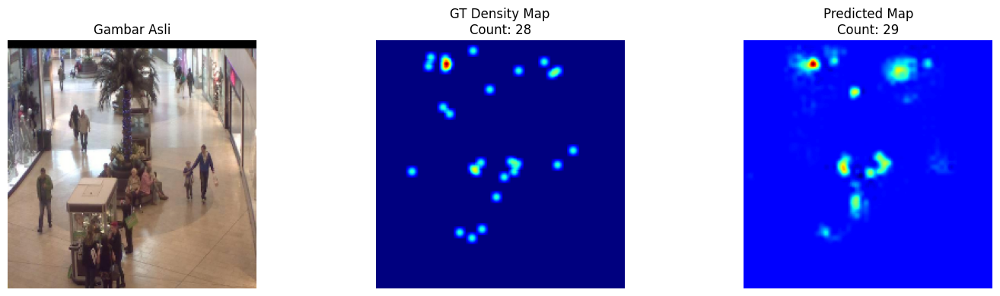

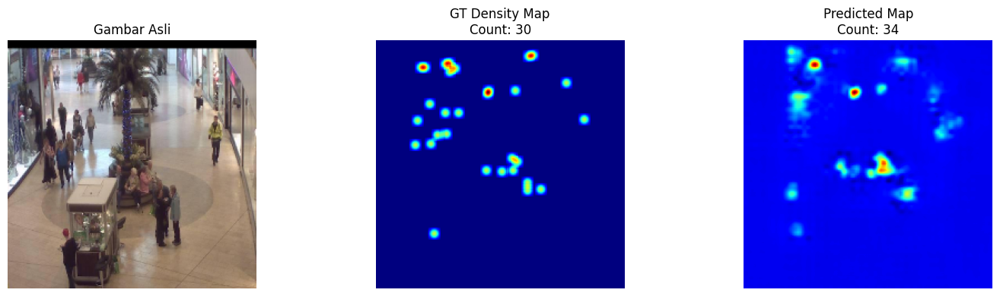

In [125]:
for i in range(len(X_batch)):
    fig, axs = plt.subplots(1, 3, figsize=(15, 4))

    axs[0].imshow(X_batch[i])
    axs[0].set_title("Gambar Asli")
    axs[0].axis("off")

    axs[1].imshow(Y_batch[i].squeeze(), cmap='jet')
    axs[1].set_title(f"GT Density Map\nCount: {Y_batch[i].sum():.0f}")
    axs[1].axis("off")

    axs[2].imshow(Y_pred[i].squeeze(), cmap='jet')
    axs[2].set_title(f"Predicted Map\nCount: {Y_pred[i].sum():.0f}")
    axs[2].axis("off")

    plt.tight_layout()
    plt.show()

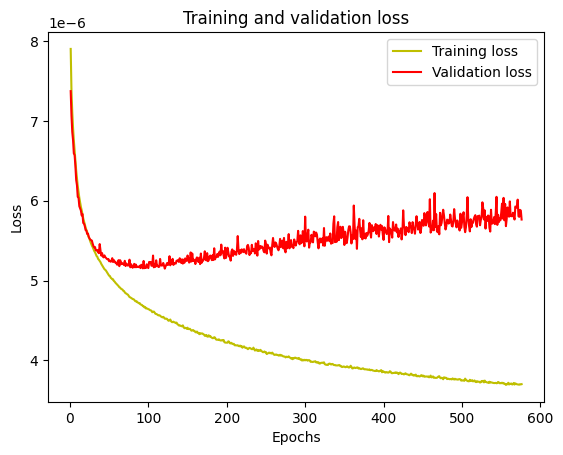

In [126]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label = 'Training loss')
plt.plot(epochs, val_loss, 'r', label = 'Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

#### Early in the training phase (around epoch 0-50), both training loss and validation loss decrease rapidly, indicating that the model is quickly learning from the data. During the mid-phase (epoch 50-150), the validation loss starts to plateau while the training loss continues to decrease, suggesting that the model fits the training data very well but begins to lose generalization capability. After approximately 150 epochs, the validation loss gradually increases, indicating the onset of overfitting. Eventually, at epoch 576, a callback function is triggered as the model stops improving (indicated by the stabilized loss). Overall, the model starts to overfit after around 150 epochs.

In [137]:
model.save("model.h5")

## Second Model (Multi-Column CNN)

#### The second model is MCNN, or Multi-Column CNN. This model is inspired by the idea that, in images with perspective distortion, people’s heads appear at very different sizes—larger when closer to the camera and smaller when farther away. If we only use filters with the same receptive field size, the model might miss important details. MCNN solves this by using multiple columns, each with different filter sizes. This allows the network to detect heads at various scales, making the density estimation more reliable across the whole image.

In [138]:
def mcnn(input_shape=(224, 224, 3)):
    inputs = Input(shape=input_shape)

    column1 = layers.Conv2D(16, (9, 9), padding='same', activation='relu')(inputs)
    column1 = layers.MaxPooling2D(pool_size=(2, 2))(column1)
    column1 = layers.Conv2D(32, (7, 7), padding='same', activation='relu')(column1)
    column1 = layers.MaxPooling2D(pool_size=(2, 2))(column1)
    column1 = layers.Conv2D(16, (7, 7), padding='same', activation='relu')(column1)
    column1 = layers.Conv2D(8, (7, 7), padding='same', activation='relu')(column1)

    column2 = layers.Conv2D(20, (7, 7), padding='same', activation='relu')(inputs)
    column2 = layers.MaxPooling2D(pool_size=(2, 2))(column2)
    column2 = layers.Conv2D(40, (5, 5), padding='same', activation='relu')(column2)
    column2 = layers.MaxPooling2D(pool_size=(2, 2))(column2)
    column2 = layers.Conv2D(20, (5, 5), padding='same', activation='relu')(column2)
    column2 = layers.Conv2D(10, (5, 5), padding='same', activation='relu')(column2)

    column3 = layers.Conv2D(24, (5, 5), padding='same', activation='relu')(inputs)
    column3 = layers.MaxPooling2D(pool_size=(2, 2))(column3)
    column3 = layers.Conv2D(48, (3, 3), padding='same', activation='relu')(column3)
    column3 = layers.MaxPooling2D(pool_size=(2, 2))(column3)
    column3 = layers.Conv2D(24, (3, 3), padding='same', activation='relu')(column3)
    column3 = layers.Conv2D(12, (3, 3), padding='same', activation='relu')(column3)

    merged = layers.concatenate([column1, column2, column3], axis=-1)

    output = layers.Conv2D(1, (1, 1), padding='same', activation='linear')(merged)

    output = tf.image.resize(output, (224, 224), method='bilinear')

    model = models.Model(inputs=inputs, outputs=output)
    return model

mcnn_model = mcnn()
mcnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss='mse')
mcnn_model.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_77 (Conv2D)             (None, 224, 224, 16  3904        ['input_10[0][0]']               
                                )                                                                 
                                                                                                  
 conv2d_81 (Conv2D)             (None, 224, 224, 20  2960        ['input_10[0][0]']               
                                )                                                           

Epoch 1/2000
350/350 [==============================] - 4s 11ms/step - loss: 1.0123e-04 - val_loss: 1.6807e-05
Epoch 2/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.3503e-05 - val_loss: 1.0895e-05
Epoch 3/2000
350/350 [==============================] - 4s 10ms/step - loss: 9.7990e-06 - val_loss: 8.7907e-06
Epoch 4/2000
350/350 [==============================] - 4s 11ms/step - loss: 8.2546e-06 - val_loss: 7.6412e-06
Epoch 5/2000
350/350 [==============================] - 4s 12ms/step - loss: 7.3664e-06 - val_loss: 6.9898e-06
Epoch 6/2000
350/350 [==============================] - 4s 10ms/step - loss: 6.8462e-06 - val_loss: 6.5667e-06
Epoch 7/2000
350/350 [==============================] - 4s 11ms/step - loss: 6.4599e-06 - val_loss: 6.1994e-06
Epoch 8/2000
350/350 [==============================] - 4s 11ms/step - loss: 6.1286e-06 - val_loss: 5.9091e-06
Epoch 9/2000
350/350 [==============================] - 4s 10ms/step - loss: 5.8503e-06 - val_loss: 5.7161e-06
E

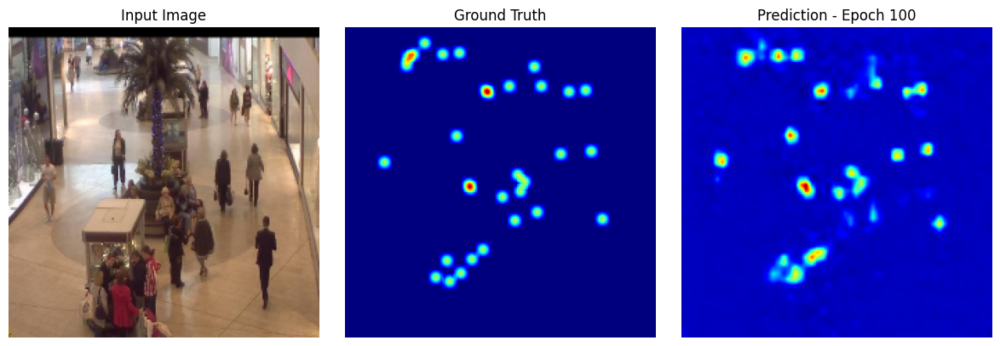

350/350 [==============================] - 4s 10ms/step - loss: 2.1783e-06 - val_loss: 2.3482e-06
Epoch 101/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1628e-06 - val_loss: 2.3091e-06
Epoch 102/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1607e-06 - val_loss: 2.3326e-06
Epoch 103/2000
350/350 [==============================] - 4s 10ms/step - loss: 2.1547e-06 - val_loss: 2.3316e-06
Epoch 104/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1496e-06 - val_loss: 2.3324e-06
Epoch 105/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1317e-06 - val_loss: 2.3320e-06
Epoch 106/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1321e-06 - val_loss: 2.3046e-06
Epoch 107/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1236e-06 - val_loss: 2.3102e-06
Epoch 108/2000
350/350 [==============================] - 3s 10ms/step - loss: 2.1173e-06 - val_loss: 2.3446e-0

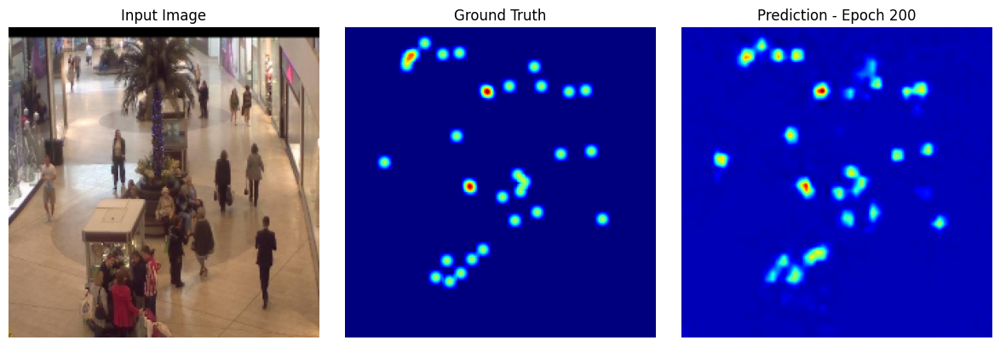

350/350 [==============================] - 4s 10ms/step - loss: 1.7624e-06 - val_loss: 2.2053e-06
Epoch 201/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7596e-06 - val_loss: 2.1570e-06
Epoch 202/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7595e-06 - val_loss: 2.1746e-06
Epoch 203/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.7533e-06 - val_loss: 2.1980e-06
Epoch 204/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7530e-06 - val_loss: 2.1857e-06
Epoch 205/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7471e-06 - val_loss: 2.1848e-06
Epoch 206/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7522e-06 - val_loss: 2.1867e-06
Epoch 207/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7440e-06 - val_loss: 2.1701e-06
Epoch 208/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.7417e-06 - val_loss: 2.1883e-0

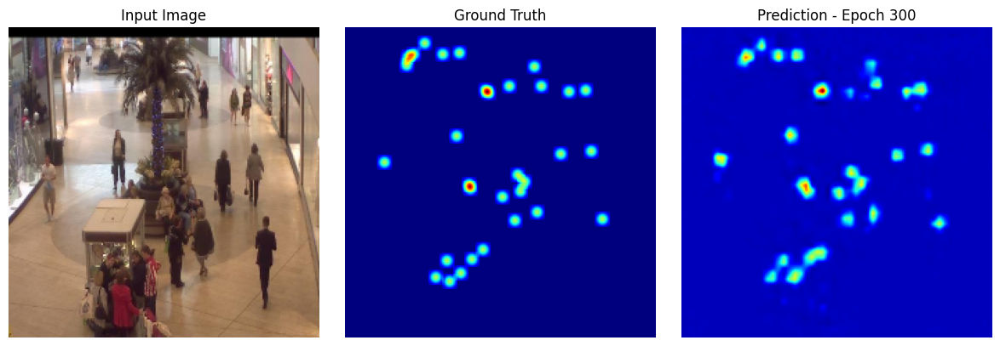

350/350 [==============================] - 4s 10ms/step - loss: 1.5578e-06 - val_loss: 2.1743e-06
Epoch 301/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5561e-06 - val_loss: 2.1829e-06
Epoch 302/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5519e-06 - val_loss: 2.1867e-06
Epoch 303/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.5493e-06 - val_loss: 2.1961e-06
Epoch 304/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5465e-06 - val_loss: 2.1795e-06
Epoch 305/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5460e-06 - val_loss: 2.1888e-06
Epoch 306/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5463e-06 - val_loss: 2.1898e-06
Epoch 307/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5451e-06 - val_loss: 2.2030e-06
Epoch 308/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.5389e-06 - val_loss: 2.1989e-0

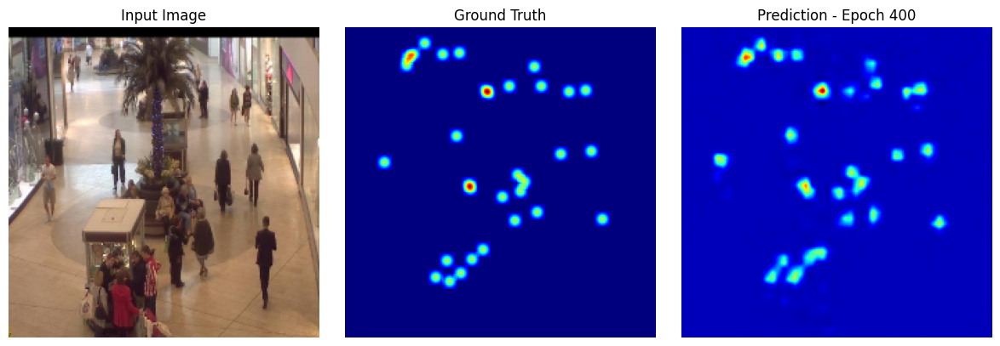

350/350 [==============================] - 4s 10ms/step - loss: 1.4189e-06 - val_loss: 2.2351e-06
Epoch 401/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4178e-06 - val_loss: 2.2353e-06
Epoch 402/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4150e-06 - val_loss: 2.2447e-06
Epoch 403/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4165e-06 - val_loss: 2.2277e-06
Epoch 404/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4143e-06 - val_loss: 2.2630e-06
Epoch 405/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4140e-06 - val_loss: 2.2286e-06
Epoch 406/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4121e-06 - val_loss: 2.2693e-06
Epoch 407/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4149e-06 - val_loss: 2.2520e-06
Epoch 408/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.4085e-06 - val_loss: 2.2304e-0

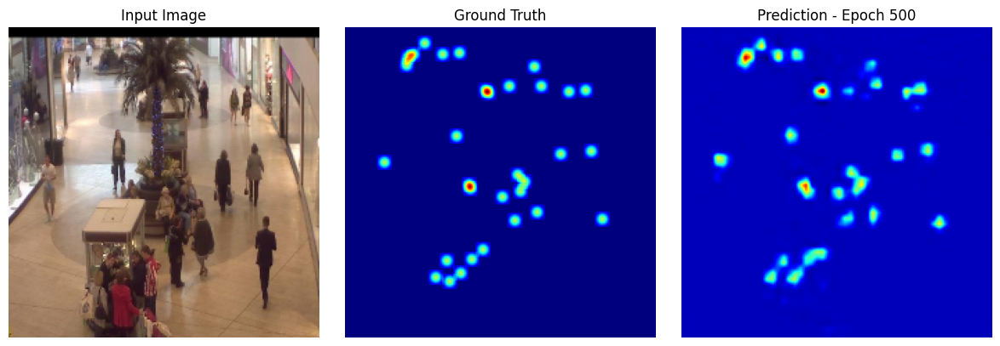

350/350 [==============================] - 4s 10ms/step - loss: 1.3184e-06 - val_loss: 2.2960e-06
Epoch 501/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3206e-06 - val_loss: 2.2554e-06
Epoch 502/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3160e-06 - val_loss: 2.2901e-06
Epoch 503/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3189e-06 - val_loss: 2.2937e-06
Epoch 504/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3128e-06 - val_loss: 2.3170e-06
Epoch 505/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3160e-06 - val_loss: 2.2973e-06
Epoch 506/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3183e-06 - val_loss: 2.2832e-06
Epoch 507/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3142e-06 - val_loss: 2.2952e-06
Epoch 508/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.3145e-06 - val_loss: 2.3088e-0

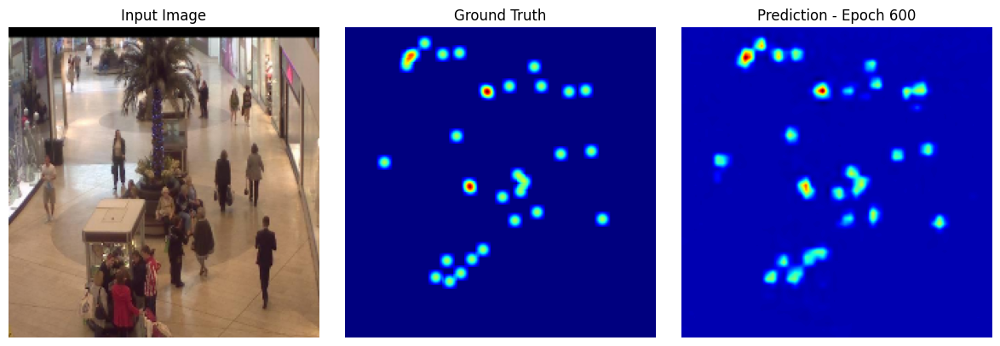

350/350 [==============================] - 4s 10ms/step - loss: 1.2454e-06 - val_loss: 2.3538e-06
Epoch 601/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2443e-06 - val_loss: 2.3525e-06
Epoch 602/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2497e-06 - val_loss: 2.3499e-06
Epoch 603/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2457e-06 - val_loss: 2.4104e-06
Epoch 604/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2405e-06 - val_loss: 2.3641e-06
Epoch 605/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2406e-06 - val_loss: 2.3464e-06
Epoch 606/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2411e-06 - val_loss: 2.3681e-06
Epoch 607/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2396e-06 - val_loss: 2.3600e-06
Epoch 608/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.2437e-06 - val_loss: 2.3571e-0

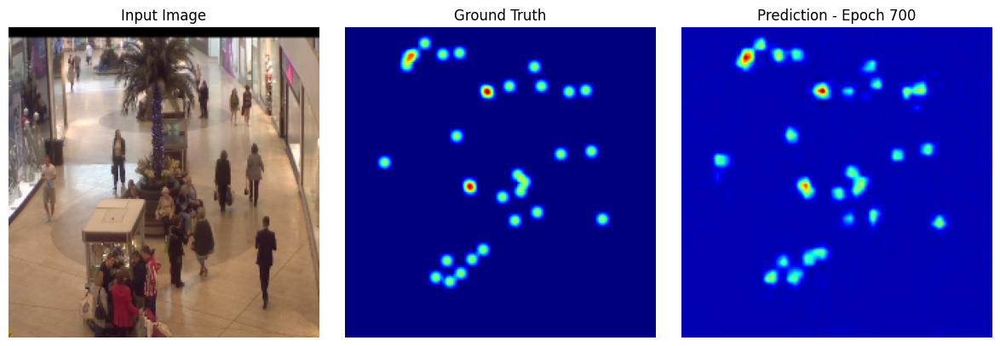

350/350 [==============================] - 4s 10ms/step - loss: 1.1869e-06 - val_loss: 2.4530e-06
Epoch 701/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1860e-06 - val_loss: 2.4318e-06
Epoch 702/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1846e-06 - val_loss: 2.4084e-06
Epoch 703/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1855e-06 - val_loss: 2.4180e-06
Epoch 704/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1859e-06 - val_loss: 2.3975e-06
Epoch 705/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1808e-06 - val_loss: 2.4083e-06
Epoch 706/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1815e-06 - val_loss: 2.4643e-06
Epoch 707/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.1850e-06 - val_loss: 2.4155e-06
Epoch 708/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1845e-06 - val_loss: 2.4438e-0

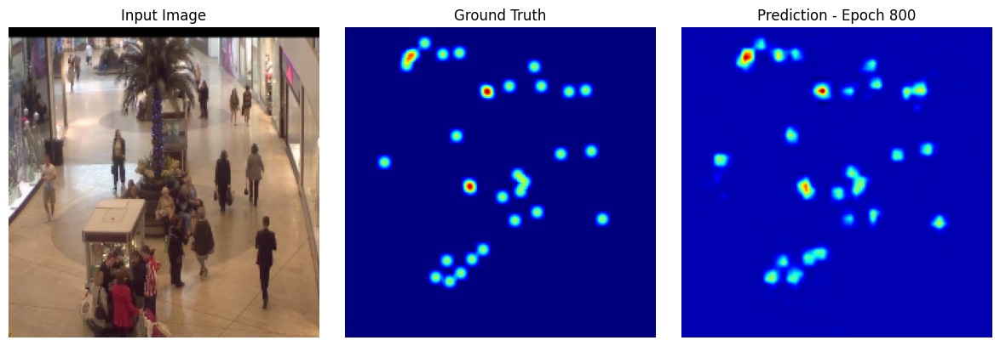

350/350 [==============================] - 4s 10ms/step - loss: 1.1353e-06 - val_loss: 2.4691e-06
Epoch 801/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1327e-06 - val_loss: 2.4782e-06
Epoch 802/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1356e-06 - val_loss: 2.4992e-06
Epoch 803/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1321e-06 - val_loss: 2.5281e-06
Epoch 804/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.1303e-06 - val_loss: 2.4656e-06
Epoch 805/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.1322e-06 - val_loss: 2.4555e-06
Epoch 806/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.1327e-06 - val_loss: 2.5120e-06
Epoch 807/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.1311e-06 - val_loss: 2.4815e-06
Epoch 808/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.1356e-06 - val_loss: 2.4644e-0

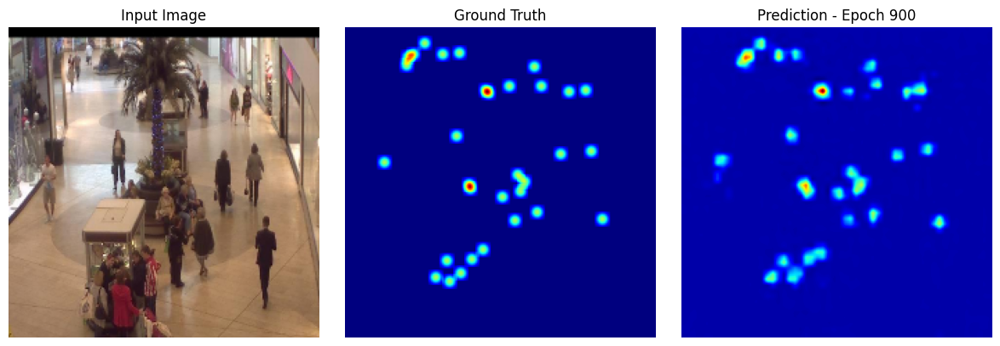

350/350 [==============================] - 4s 10ms/step - loss: 1.0914e-06 - val_loss: 2.5013e-06
Epoch 901/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0923e-06 - val_loss: 2.6132e-06
Epoch 902/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0907e-06 - val_loss: 2.5847e-06
Epoch 903/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0937e-06 - val_loss: 2.5343e-06
Epoch 904/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.0921e-06 - val_loss: 2.5210e-06
Epoch 905/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0916e-06 - val_loss: 2.5345e-06
Epoch 906/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0915e-06 - val_loss: 2.5236e-06
Epoch 907/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0896e-06 - val_loss: 2.5547e-06
Epoch 908/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0880e-06 - val_loss: 2.5962e-0

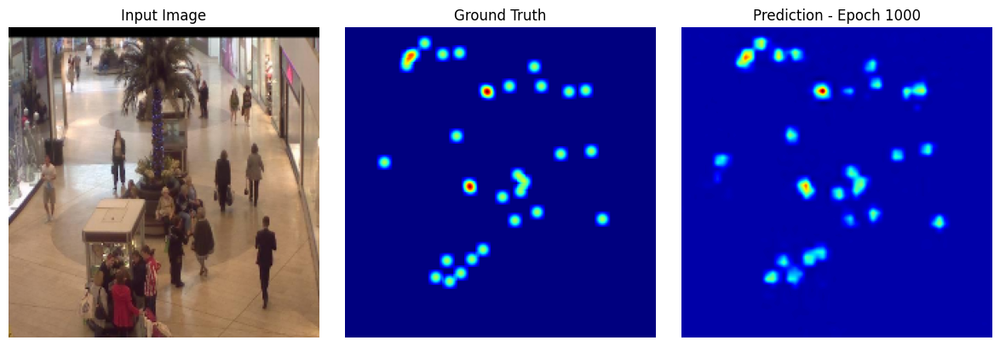

350/350 [==============================] - 4s 10ms/step - loss: 1.0577e-06 - val_loss: 2.5985e-06
Epoch 1001/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0552e-06 - val_loss: 2.5944e-06
Epoch 1002/2000
350/350 [==============================] - 4s 10ms/step - loss: 1.0570e-06 - val_loss: 2.6003e-06
Epoch 1003/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0552e-06 - val_loss: 2.5494e-06
Epoch 1004/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0522e-06 - val_loss: 2.6130e-06
Epoch 1005/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0560e-06 - val_loss: 2.5870e-06
Epoch 1006/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0578e-06 - val_loss: 2.6070e-06
Epoch 1007/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0540e-06 - val_loss: 2.5927e-06
Epoch 1008/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0547e-06 - val_loss: 2

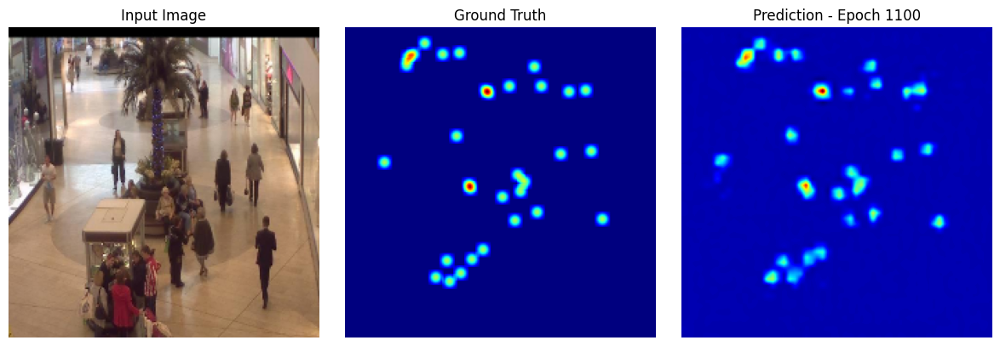

350/350 [==============================] - 4s 10ms/step - loss: 1.0246e-06 - val_loss: 2.6379e-06
Epoch 1101/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0287e-06 - val_loss: 2.6133e-06
Epoch 1102/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0290e-06 - val_loss: 2.6572e-06
Epoch 1103/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0280e-06 - val_loss: 2.6765e-06
Epoch 1104/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0263e-06 - val_loss: 2.6711e-06
Epoch 1105/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0250e-06 - val_loss: 2.6545e-06
Epoch 1106/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0258e-06 - val_loss: 2.6275e-06
Epoch 1107/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0214e-06 - val_loss: 2.6819e-06
Epoch 1108/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0227e-06 - val_loss: 2

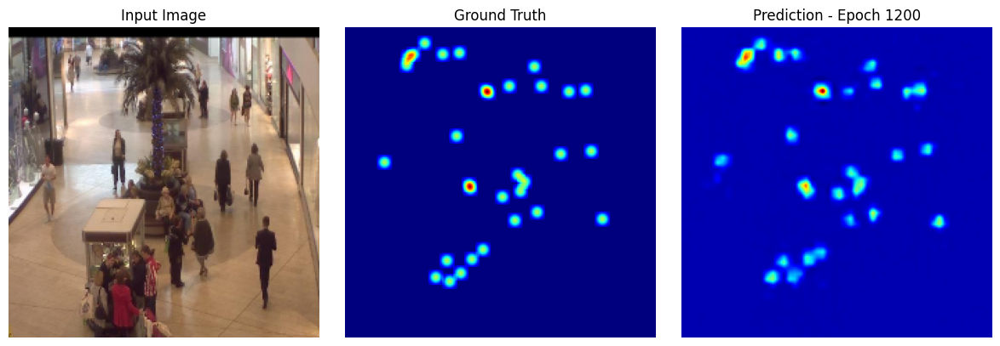

350/350 [==============================] - 4s 10ms/step - loss: 9.9821e-07 - val_loss: 2.7177e-06
Epoch 1201/2000
350/350 [==============================] - 4s 10ms/step - loss: 9.9942e-07 - val_loss: 2.7246e-06
Epoch 1202/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0004e-06 - val_loss: 2.6983e-06
Epoch 1203/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0004e-06 - val_loss: 2.7087e-06
Epoch 1204/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0008e-06 - val_loss: 2.6681e-06
Epoch 1205/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.9726e-07 - val_loss: 2.7185e-06
Epoch 1206/2000
350/350 [==============================] - 3s 10ms/step - loss: 1.0043e-06 - val_loss: 2.6816e-06
Epoch 1207/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.9949e-07 - val_loss: 2.7864e-06
Epoch 1208/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.9729e-07 - val_loss: 2

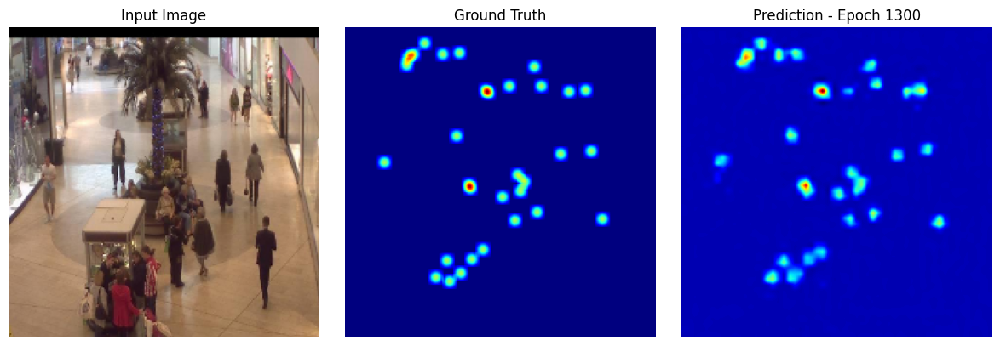

350/350 [==============================] - 4s 10ms/step - loss: 9.7419e-07 - val_loss: 2.7841e-06
Epoch 1301/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.8088e-07 - val_loss: 2.7483e-06
Epoch 1302/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7302e-07 - val_loss: 2.7434e-06
Epoch 1303/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7536e-07 - val_loss: 2.7430e-06
Epoch 1304/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7975e-07 - val_loss: 2.7600e-06
Epoch 1305/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7532e-07 - val_loss: 2.7639e-06
Epoch 1306/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7499e-07 - val_loss: 2.7347e-06
Epoch 1307/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7271e-07 - val_loss: 2.7726e-06
Epoch 1308/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.7564e-07 - val_loss: 2

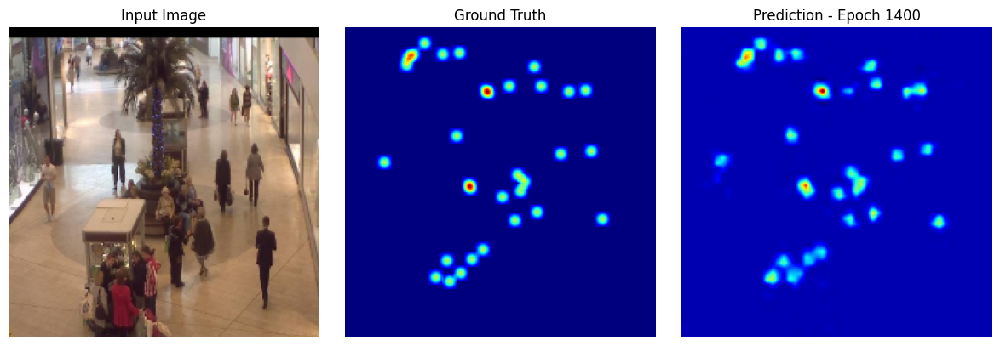

350/350 [==============================] - 4s 10ms/step - loss: 9.5396e-07 - val_loss: 2.7722e-06
Epoch 1401/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5773e-07 - val_loss: 2.7958e-06
Epoch 1402/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5442e-07 - val_loss: 2.8102e-06
Epoch 1403/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5641e-07 - val_loss: 2.7750e-06
Epoch 1404/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5622e-07 - val_loss: 2.7529e-06
Epoch 1405/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.6064e-07 - val_loss: 2.7500e-06
Epoch 1406/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5974e-07 - val_loss: 2.7658e-06
Epoch 1407/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5213e-07 - val_loss: 2.7590e-06
Epoch 1408/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.5449e-07 - val_loss: 2

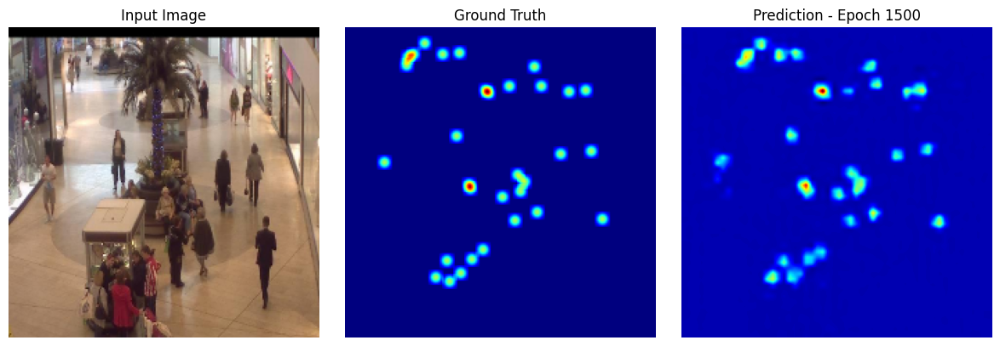

350/350 [==============================] - 4s 10ms/step - loss: 9.3621e-07 - val_loss: 2.8768e-06
Epoch 1501/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3873e-07 - val_loss: 2.8869e-06
Epoch 1502/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3614e-07 - val_loss: 2.8268e-06
Epoch 1503/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3925e-07 - val_loss: 2.8113e-06
Epoch 1504/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3592e-07 - val_loss: 2.8061e-06
Epoch 1505/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3877e-07 - val_loss: 2.7997e-06
Epoch 1506/2000
350/350 [==============================] - 4s 10ms/step - loss: 9.3530e-07 - val_loss: 2.8450e-06
Epoch 1507/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3664e-07 - val_loss: 2.8360e-06
Epoch 1508/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.3197e-07 - val_loss: 2

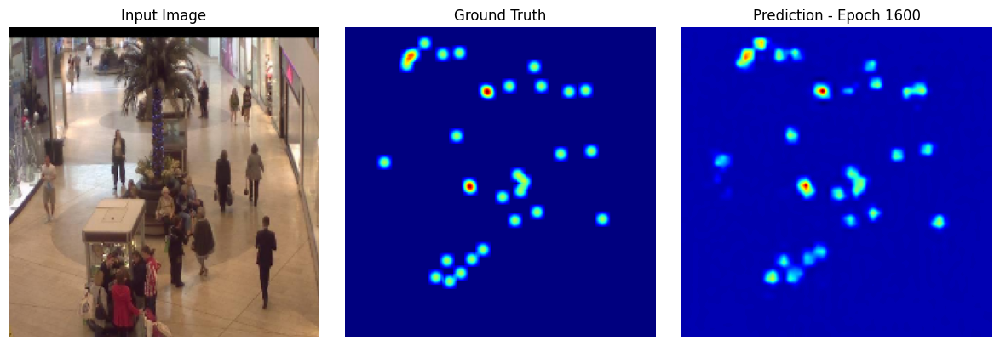

350/350 [==============================] - 4s 10ms/step - loss: 9.2150e-07 - val_loss: 2.8189e-06
Epoch 1601/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2224e-07 - val_loss: 2.8738e-06
Epoch 1602/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2391e-07 - val_loss: 2.8637e-06
Epoch 1603/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2335e-07 - val_loss: 2.8757e-06
Epoch 1604/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2093e-07 - val_loss: 2.8499e-06
Epoch 1605/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.1744e-07 - val_loss: 2.8509e-06
Epoch 1606/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2019e-07 - val_loss: 2.8763e-06
Epoch 1607/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2241e-07 - val_loss: 2.8779e-06
Epoch 1608/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.2093e-07 - val_loss: 2

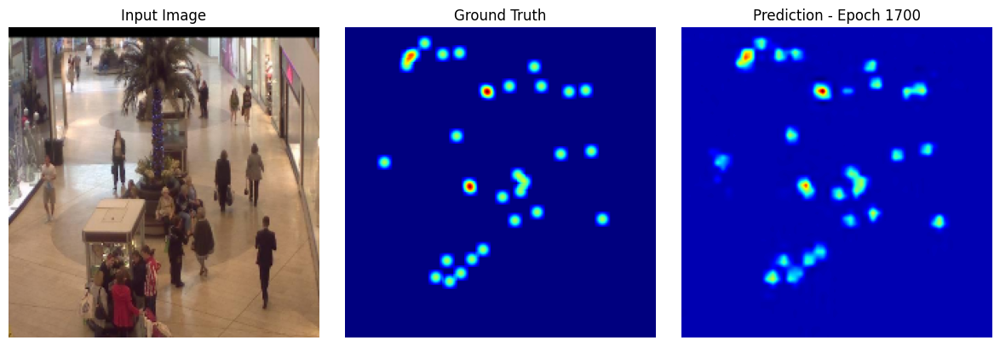

350/350 [==============================] - 4s 10ms/step - loss: 9.0400e-07 - val_loss: 2.9273e-06
Epoch 1701/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0768e-07 - val_loss: 2.8551e-06
Epoch 1702/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0855e-07 - val_loss: 2.9820e-06
Epoch 1703/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0616e-07 - val_loss: 2.9505e-06
Epoch 1704/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0799e-07 - val_loss: 2.8830e-06
Epoch 1705/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0908e-07 - val_loss: 2.9124e-06
Epoch 1706/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0677e-07 - val_loss: 2.9158e-06
Epoch 1707/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0817e-07 - val_loss: 2.9443e-06
Epoch 1708/2000
350/350 [==============================] - 3s 10ms/step - loss: 9.0368e-07 - val_loss: 2

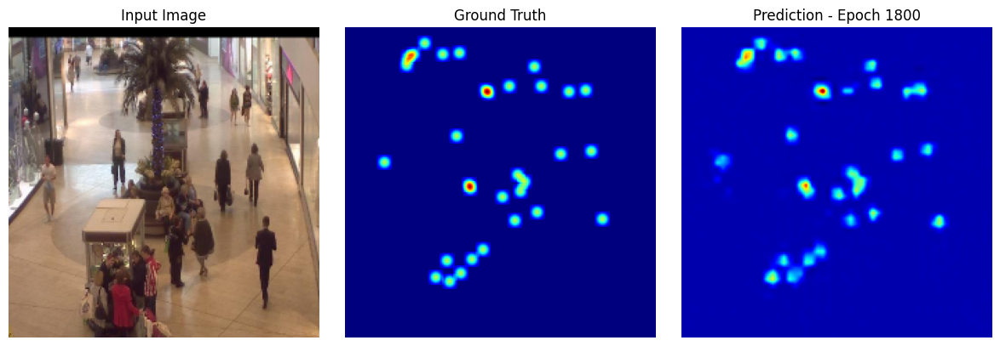

350/350 [==============================] - 4s 10ms/step - loss: 8.9361e-07 - val_loss: 2.9418e-06
Epoch 1801/2000
350/350 [==============================] - 4s 10ms/step - loss: 8.9274e-07 - val_loss: 2.9163e-06
Epoch 1802/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9355e-07 - val_loss: 2.9730e-06
Epoch 1803/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9390e-07 - val_loss: 2.9253e-06
Epoch 1804/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9161e-07 - val_loss: 2.8976e-06
Epoch 1805/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9689e-07 - val_loss: 2.9723e-06
Epoch 1806/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9350e-07 - val_loss: 2.9458e-06
Epoch 1807/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9416e-07 - val_loss: 2.9702e-06
Epoch 1808/2000
350/350 [==============================] - 3s 10ms/step - loss: 8.9109e-07 - val_loss: 2

In [139]:
history = mcnn_model.fit(train_gen, validation_data = valid_gen ,epochs=2000, callbacks=[check_point, plot_callback])

In [173]:
for i in range(len(test_gen)):
    print(i)
    X_batch, Y_batch = test_gen[i]
    Y_pred = mcnn_model.predict(X_batch)

0
1/1 [==============================] - 0s 17ms/step
1
1/1 [==============================] - 0s 13ms/step
2
1/1 [==============================] - 0s 12ms/step
3
1/1 [==============================] - 0s 12ms/step
4
1/1 [==============================] - 0s 11ms/step
5
1/1 [==============================] - 0s 11ms/step
6
1/1 [==============================] - 0s 11ms/step
7
1/1 [==============================] - 0s 10ms/step
8
1/1 [==============================] - 0s 11ms/step
9
1/1 [==============================] - 0s 11ms/step
10
1/1 [==============================] - 0s 10ms/step
11
1/1 [==============================] - 0s 10ms/step
12
1/1 [==============================] - 0s 12ms/step
13
1/1 [==============================] - 0s 12ms/step
14
1/1 [==============================] - 0s 11ms/step
15
1/1 [==============================] - 0s 12ms/step
16
1/1 [==============================] - 0s 11ms/step
17
1/1 [==============================] - 0s 11ms/step
18
1/1 [============

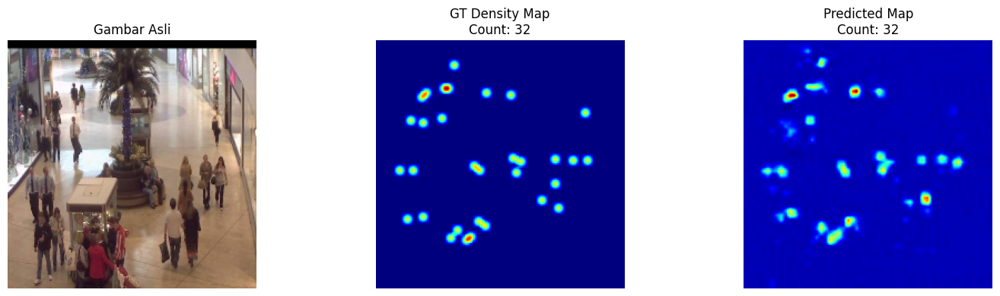

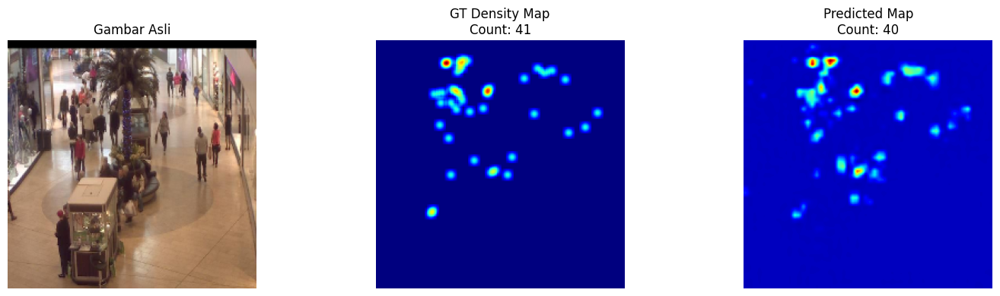

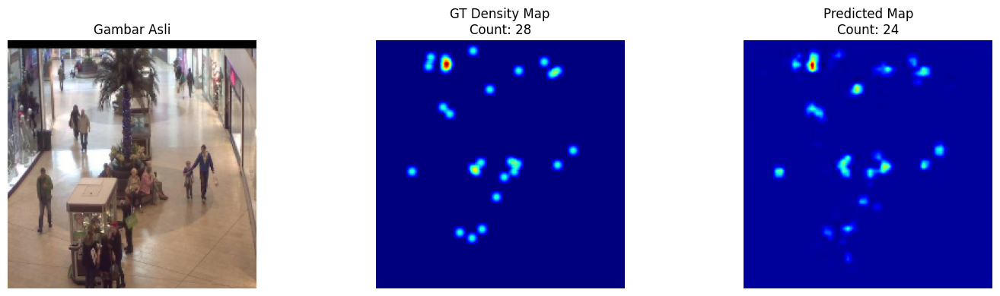

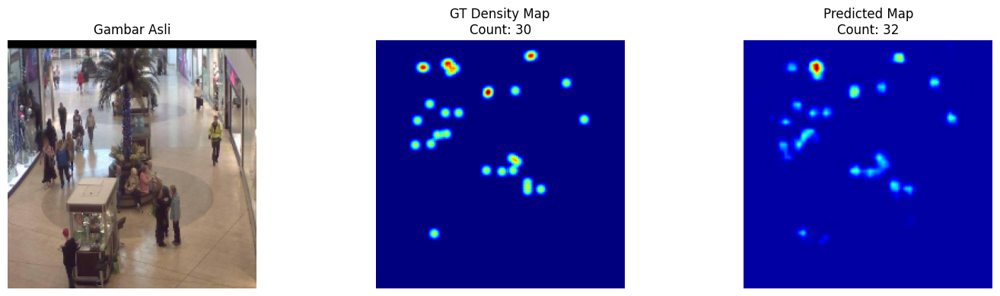

In [174]:
for i in range(len(X_batch)):
    fig, axs = plt.subplots(1, 3, figsize=(15, 4))

    axs[0].imshow(X_batch[i])
    axs[0].set_title("Gambar Asli")
    axs[0].axis("off")

    axs[1].imshow(Y_batch[i].squeeze(), cmap='jet')
    axs[1].set_title(f"GT Density Map\nCount: {Y_batch[i].sum():.0f}")
    axs[1].axis("off")

    axs[2].imshow(Y_pred[i].squeeze(), cmap='jet')
    axs[2].set_title(f"Predicted Map\nCount: {Y_pred[i].sum():.0f}")
    axs[2].axis("off")

    plt.tight_layout()
    plt.show()


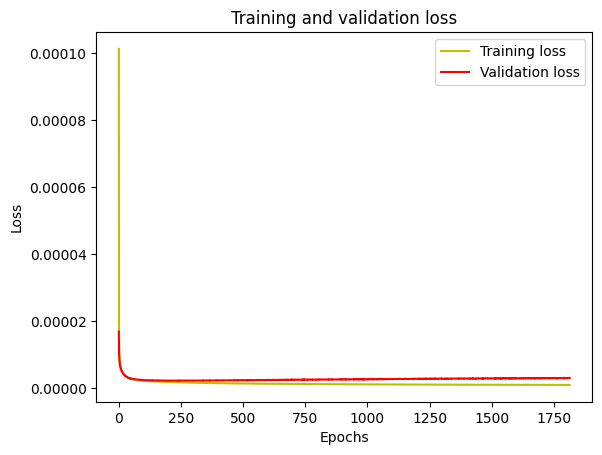

In [142]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label = 'Training loss')
plt.plot(epochs, val_loss, 'r', label = 'Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

#### At the early phase of training (around epoch 0-50), both training and validation losses decrease very rapidly, indicating that the model quickly captures the underlying patterns in the data. As training progresses beyond epoch 50, both losses continue to decrease slowly while remaining closely aligned, showing that the model maintains a strong generalization ability and does not suffer from significant overfitting. Even after a large number of epochs (up to 1750), the training and validation losses remain stable and converge to very low values, indicating a well-fitted and stable model with good learning capability on both training and unseen data.

In [143]:
mcnn_model.save("mcnn_model.h5")

## Third Model ResNet101 + Decoder

#### The third model we tested is ResNet101 with a decoder. We used ResNet101 to see if using a deeper network (with 101 layers) would improve performance. ResNet is especially designed to avoid the vanishing gradient problem by using residual connections, which help the model keep learning effectively even as it gets deeper. After ResNet extracts the features, we added a decoder using Conv2DTranspose and upsampling to recover the spatial resolution, so that the output matches the input size as closely as possible.

In [144]:
def ResNet101(input_shape=(224, 224, 3)):
    base_model = applications.ResNet101(include_top=False, weights='imagenet', input_shape=input_shape)
    for layer in base_model.layers:
        layer.trainable = False

    x = base_model.output  # (7, 7, 2048)

    x = layers.Conv2D(512, 3, padding='same', activation='relu')(x)
    x = layers.Conv2D(256, 3, padding='same', activation='relu')(x)
    x = layers.Conv2D(128, 3, padding='same', activation='relu')(x)
    x = layers.Conv2D(64, 3, padding='same', activation='relu')(x)
    x = layers.Conv2D(1, 1, padding='same')(x)
    
    x = layers.Conv2DTranspose(128, 3, strides=2, padding='same', activation='relu')(x) 
    x = layers.UpSampling2D(size=(2, 2), interpolation='bilinear')(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, padding='same', activation='relu')(x)   
    x = layers.UpSampling2D(size=(2, 2), interpolation='bilinear')(x)
    x = layers.Conv2DTranspose(1, 3, strides=2, padding='same')(x)


    model = models.Model(inputs=base_model.input, outputs=x)
    return model

In [145]:
model3 = ResNet101()
model3.compile(optimizer=Adam(learning_rate=1e-4), loss='mse')

model3.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_11[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

Epoch 1/2000
350/350 [==============================] - 11s 24ms/step - loss: 7.7824e-06 - val_loss: 7.1679e-06
Epoch 2/2000
350/350 [==============================] - 7s 21ms/step - loss: 7.1606e-06 - val_loss: 6.8998e-06
Epoch 3/2000
350/350 [==============================] - 7s 21ms/step - loss: 6.9284e-06 - val_loss: 6.7051e-06
Epoch 4/2000
350/350 [==============================] - 8s 21ms/step - loss: 6.7818e-06 - val_loss: 6.6206e-06
Epoch 5/2000
350/350 [==============================] - 8s 21ms/step - loss: 6.6579e-06 - val_loss: 6.4907e-06
Epoch 6/2000
350/350 [==============================] - 7s 21ms/step - loss: 6.5586e-06 - val_loss: 6.4526e-06
Epoch 7/2000
350/350 [==============================] - 7s 21ms/step - loss: 6.4838e-06 - val_loss: 6.3833e-06
Epoch 8/2000
350/350 [==============================] - 7s 21ms/step - loss: 6.4089e-06 - val_loss: 6.2802e-06
Epoch 9/2000
350/350 [==============================] - 8s 22ms/step - loss: 6.3503e-06 - val_loss: 6.2461e-06


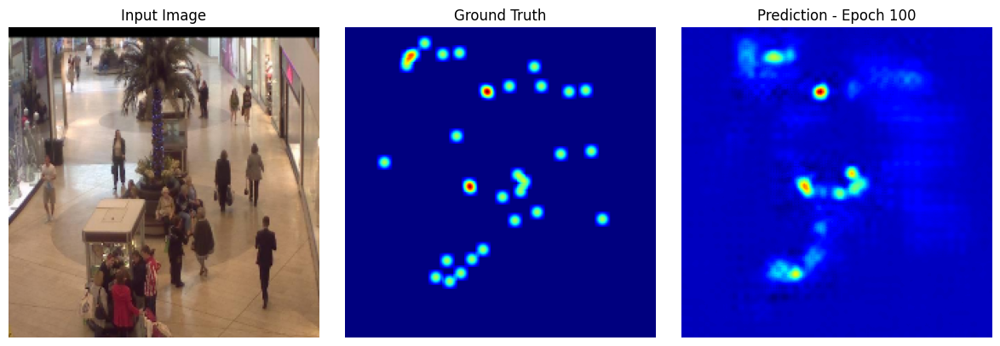

350/350 [==============================] - 8s 24ms/step - loss: 5.2235e-06 - val_loss: 5.1949e-06
Epoch 101/2000
350/350 [==============================] - 7s 21ms/step - loss: 5.2149e-06 - val_loss: 5.3287e-06
Epoch 102/2000
350/350 [==============================] - 7s 21ms/step - loss: 5.2242e-06 - val_loss: 5.2112e-06
Epoch 103/2000
350/350 [==============================] - 8s 21ms/step - loss: 5.2140e-06 - val_loss: 5.2066e-06
Epoch 104/2000
350/350 [==============================] - 8s 21ms/step - loss: 5.2042e-06 - val_loss: 5.2235e-06
Epoch 105/2000
350/350 [==============================] - 8s 22ms/step - loss: 5.2008e-06 - val_loss: 5.2000e-06
Epoch 106/2000
350/350 [==============================] - 7s 21ms/step - loss: 5.1980e-06 - val_loss: 5.2268e-06
Epoch 107/2000
350/350 [==============================] - 8s 21ms/step - loss: 5.2043e-06 - val_loss: 5.2050e-06
Epoch 108/2000
350/350 [==============================] - 7s 21ms/step - loss: 5.1977e-06 - val_loss: 5.2361e-0

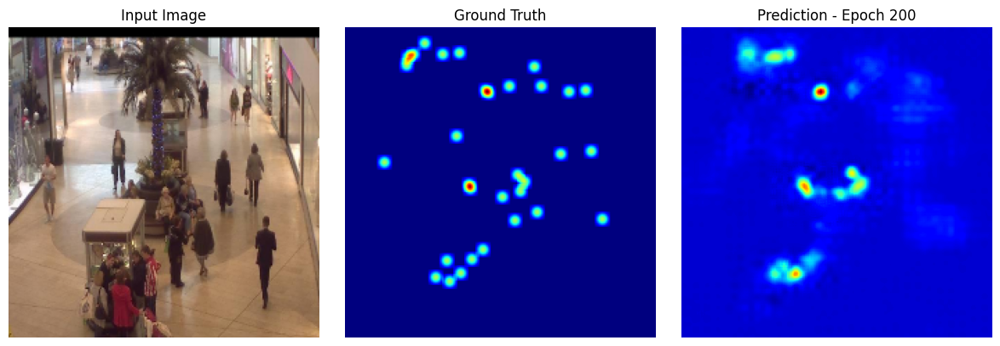

350/350 [==============================] - 8s 22ms/step - loss: 4.9092e-06 - val_loss: 5.0456e-06
Epoch 201/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.9023e-06 - val_loss: 5.0850e-06
Epoch 202/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.8966e-06 - val_loss: 5.0855e-06
Epoch 203/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.8992e-06 - val_loss: 5.0936e-06
Epoch 204/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.8926e-06 - val_loss: 5.0519e-06
Epoch 205/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.8978e-06 - val_loss: 5.0620e-06
Epoch 206/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.8976e-06 - val_loss: 5.0811e-06
Epoch 207/2000
350/350 [==============================] - 8s 22ms/step - loss: 4.8956e-06 - val_loss: 5.0454e-06
Epoch 208/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.8991e-06 - val_loss: 5.0559e-0

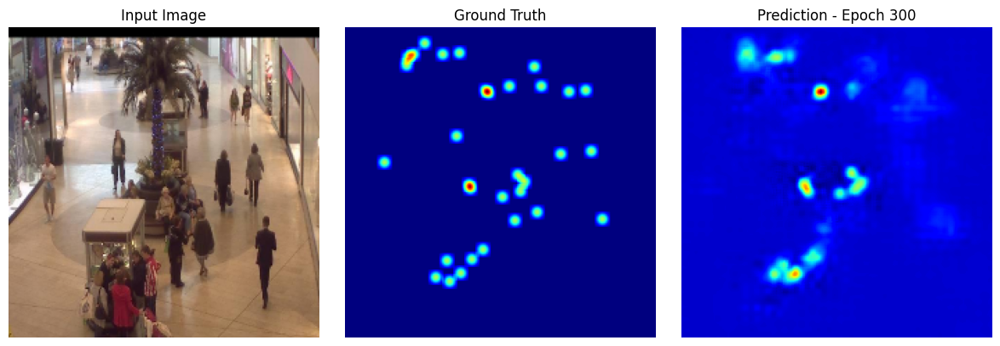

350/350 [==============================] - 8s 22ms/step - loss: 4.6792e-06 - val_loss: 4.9497e-06
Epoch 301/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6724e-06 - val_loss: 4.9713e-06
Epoch 302/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6848e-06 - val_loss: 4.9619e-06
Epoch 303/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6838e-06 - val_loss: 4.9732e-06
Epoch 304/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6825e-06 - val_loss: 4.9609e-06
Epoch 305/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6778e-06 - val_loss: 4.9767e-06
Epoch 306/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.6637e-06 - val_loss: 4.9425e-06
Epoch 307/2000
350/350 [==============================] - 8s 22ms/step - loss: 4.6722e-06 - val_loss: 4.9373e-06
Epoch 308/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.6614e-06 - val_loss: 4.9490e-0

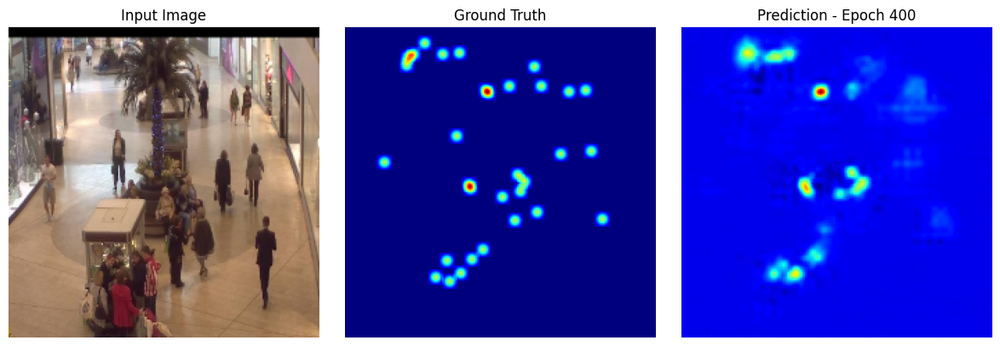

350/350 [==============================] - 8s 22ms/step - loss: 4.4876e-06 - val_loss: 4.9613e-06
Epoch 401/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4891e-06 - val_loss: 4.9167e-06
Epoch 402/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4903e-06 - val_loss: 4.8945e-06
Epoch 403/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4982e-06 - val_loss: 4.9106e-06
Epoch 404/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4809e-06 - val_loss: 4.9069e-06
Epoch 405/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4906e-06 - val_loss: 4.9099e-06
Epoch 406/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4855e-06 - val_loss: 4.9250e-06
Epoch 407/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4825e-06 - val_loss: 4.9190e-06
Epoch 408/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.4873e-06 - val_loss: 4.9127e-0

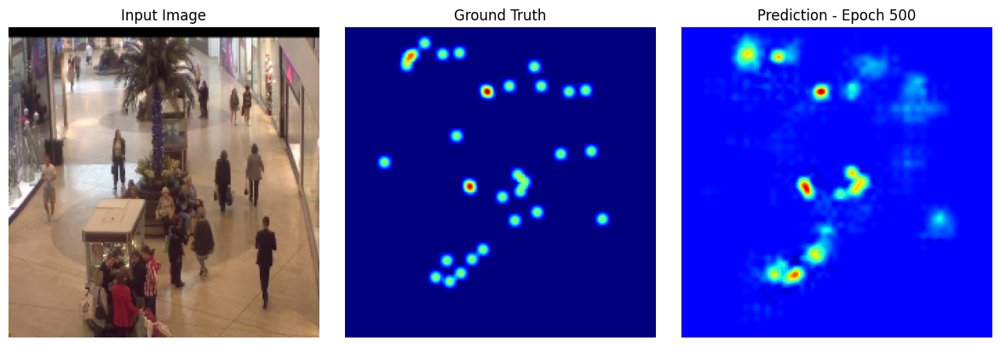

350/350 [==============================] - 8s 22ms/step - loss: 4.3488e-06 - val_loss: 4.9175e-06
Epoch 501/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.3333e-06 - val_loss: 4.9125e-06
Epoch 502/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.3340e-06 - val_loss: 4.8865e-06
Epoch 503/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.3364e-06 - val_loss: 4.9405e-06
Epoch 504/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.3313e-06 - val_loss: 4.8966e-06
Epoch 505/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.3234e-06 - val_loss: 4.9173e-06
Epoch 506/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.3282e-06 - val_loss: 4.9075e-06
Epoch 507/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.3412e-06 - val_loss: 4.9359e-06
Epoch 508/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.3377e-06 - val_loss: 4.9309e-0

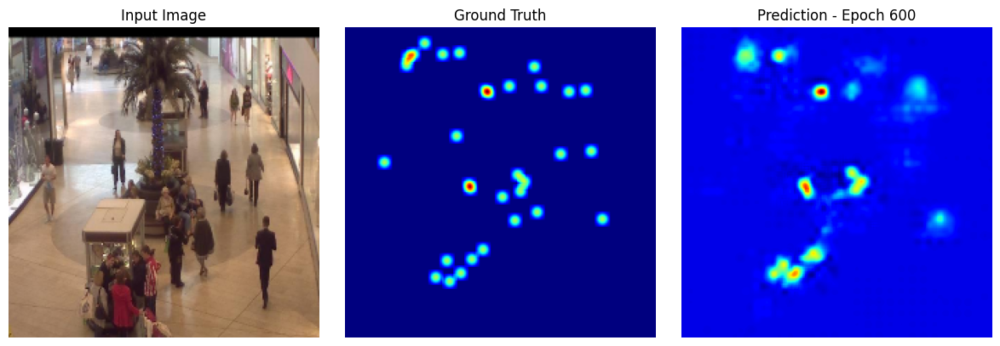

350/350 [==============================] - 8s 22ms/step - loss: 4.2179e-06 - val_loss: 4.9188e-06
Epoch 601/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.2106e-06 - val_loss: 4.9103e-06
Epoch 602/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.2122e-06 - val_loss: 4.9173e-06
Epoch 603/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.2108e-06 - val_loss: 4.9222e-06
Epoch 604/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.2144e-06 - val_loss: 4.8997e-06
Epoch 605/2000
350/350 [==============================] - 8s 22ms/step - loss: 4.2131e-06 - val_loss: 4.9272e-06
Epoch 606/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.2041e-06 - val_loss: 4.9223e-06
Epoch 607/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.2230e-06 - val_loss: 4.9035e-06
Epoch 608/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1994e-06 - val_loss: 4.9281e-0

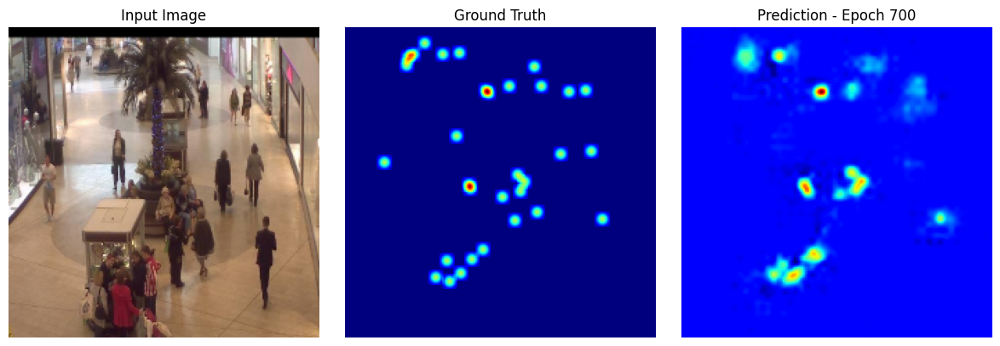

350/350 [==============================] - 8s 22ms/step - loss: 4.1118e-06 - val_loss: 4.9599e-06
Epoch 701/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1177e-06 - val_loss: 4.9323e-06
Epoch 702/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1269e-06 - val_loss: 4.9501e-06
Epoch 703/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1111e-06 - val_loss: 4.9392e-06
Epoch 704/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1256e-06 - val_loss: 4.9342e-06
Epoch 705/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1046e-06 - val_loss: 4.9424e-06
Epoch 706/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.1143e-06 - val_loss: 4.9836e-06
Epoch 707/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.1023e-06 - val_loss: 4.9706e-06
Epoch 708/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.1054e-06 - val_loss: 4.9880e-0

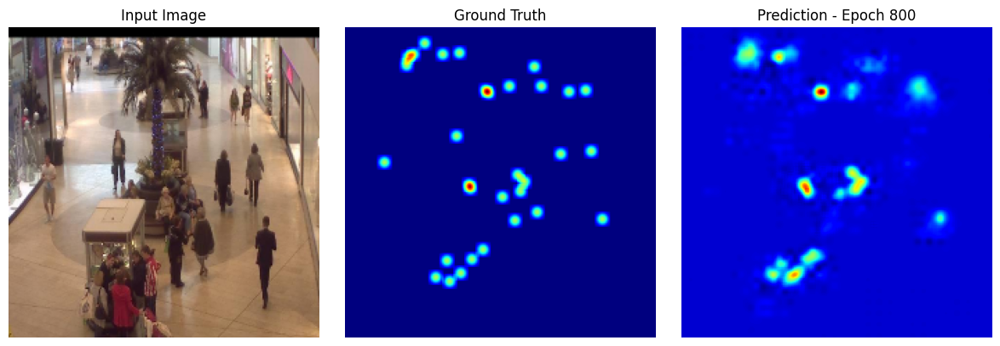

350/350 [==============================] - 8s 22ms/step - loss: 4.0307e-06 - val_loss: 4.9849e-06
Epoch 801/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.0437e-06 - val_loss: 4.9821e-06
Epoch 802/2000
350/350 [==============================] - 8s 22ms/step - loss: 4.0367e-06 - val_loss: 4.9981e-06
Epoch 803/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.0335e-06 - val_loss: 4.9853e-06
Epoch 804/2000
350/350 [==============================] - 8s 22ms/step - loss: 4.0423e-06 - val_loss: 4.9885e-06
Epoch 805/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.0316e-06 - val_loss: 5.0032e-06
Epoch 806/2000
350/350 [==============================] - 7s 21ms/step - loss: 4.0375e-06 - val_loss: 5.0057e-06
Epoch 807/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.0222e-06 - val_loss: 4.9492e-06
Epoch 808/2000
350/350 [==============================] - 8s 21ms/step - loss: 4.0177e-06 - val_loss: 4.9654e-0

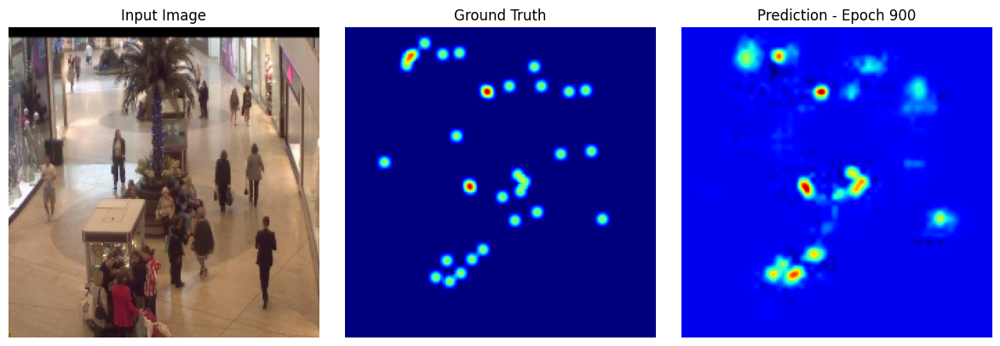

350/350 [==============================] - 8s 22ms/step - loss: 3.9513e-06 - val_loss: 5.0700e-06
Epoch 901/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9689e-06 - val_loss: 5.0086e-06
Epoch 902/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9590e-06 - val_loss: 5.0253e-06
Epoch 903/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9627e-06 - val_loss: 5.0353e-06
Epoch 904/2000
350/350 [==============================] - 8s 21ms/step - loss: 3.9629e-06 - val_loss: 5.0062e-06
Epoch 905/2000
350/350 [==============================] - 8s 22ms/step - loss: 3.9492e-06 - val_loss: 5.0518e-06
Epoch 906/2000
350/350 [==============================] - 8s 22ms/step - loss: 3.9682e-06 - val_loss: 5.0187e-06
Epoch 907/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9553e-06 - val_loss: 5.0468e-06
Epoch 908/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9545e-06 - val_loss: 5.0172e-0

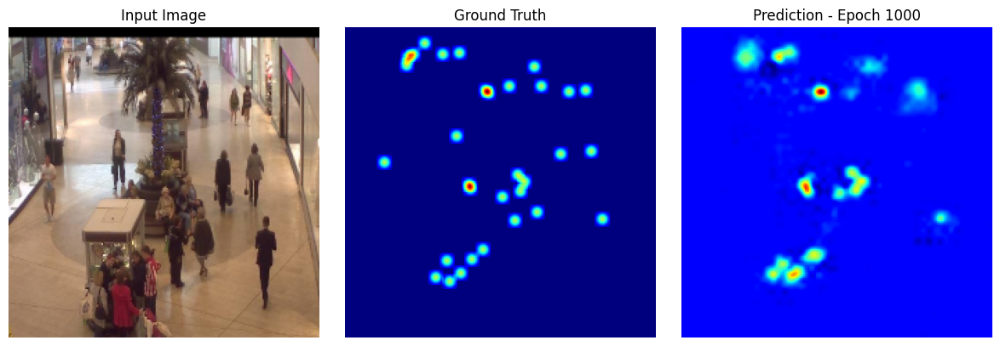

350/350 [==============================] - 8s 22ms/step - loss: 3.9008e-06 - val_loss: 5.0710e-06
Epoch 1001/2000
350/350 [==============================] - 8s 21ms/step - loss: 3.8948e-06 - val_loss: 5.0164e-06
Epoch 1002/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.8940e-06 - val_loss: 5.0825e-06
Epoch 1003/2000
350/350 [==============================] - 8s 21ms/step - loss: 3.8955e-06 - val_loss: 5.0609e-06
Epoch 1004/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.8912e-06 - val_loss: 5.0641e-06
Epoch 1005/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.9061e-06 - val_loss: 5.1450e-06
Epoch 1006/2000
350/350 [==============================] - 8s 21ms/step - loss: 3.9083e-06 - val_loss: 5.0995e-06
Epoch 1007/2000
350/350 [==============================] - 8s 22ms/step - loss: 3.8960e-06 - val_loss: 5.0405e-06
Epoch 1008/2000
350/350 [==============================] - 7s 21ms/step - loss: 3.8877e-06 - val_loss: 5

In [146]:
history = model3.fit(train_gen, validation_data = valid_gen ,epochs=2000, callbacks=[check_point, plot_callback])

In [175]:
for i in range(len(test_gen)):
    print(i)
    X_batch, Y_batch = test_gen[i]
    Y_pred = model3.predict(X_batch)

0
1/1 [==============================] - 0s 37ms/step
1
1/1 [==============================] - 0s 25ms/step
2
1/1 [==============================] - 0s 21ms/step
3
1/1 [==============================] - 0s 20ms/step
4
1/1 [==============================] - 0s 19ms/step
5
1/1 [==============================] - 0s 19ms/step
6
1/1 [==============================] - 0s 25ms/step
7
1/1 [==============================] - 0s 20ms/step
8
1/1 [==============================] - 0s 19ms/step
9
1/1 [==============================] - 0s 19ms/step
10
1/1 [==============================] - 0s 19ms/step
11
1/1 [==============================] - 0s 17ms/step
12
1/1 [==============================] - 0s 18ms/step
13
1/1 [==============================] - 0s 18ms/step
14
1/1 [==============================] - 0s 17ms/step
15
1/1 [==============================] - 0s 17ms/step
16
1/1 [==============================] - 0s 17ms/step
17
1/1 [==============================] - 0s 19ms/step
18
1/1 [============

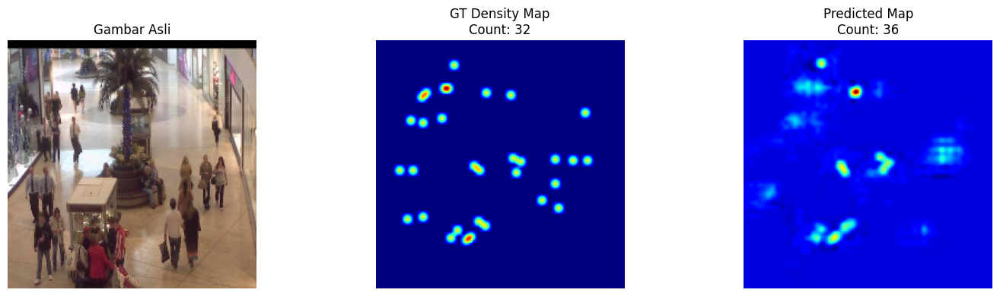

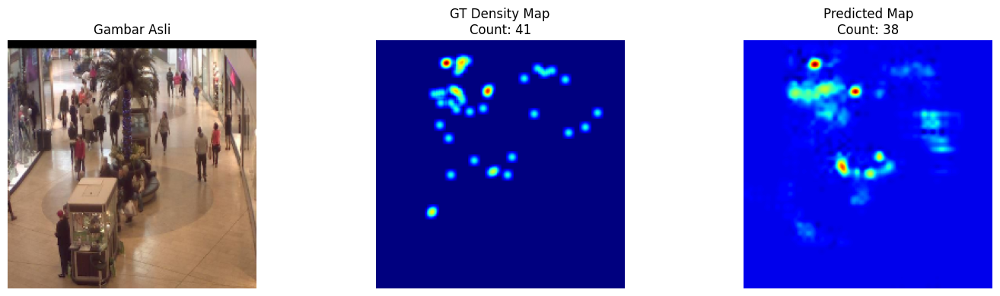

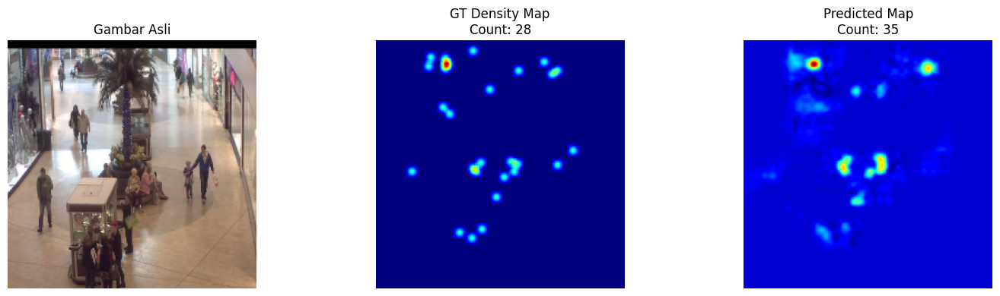

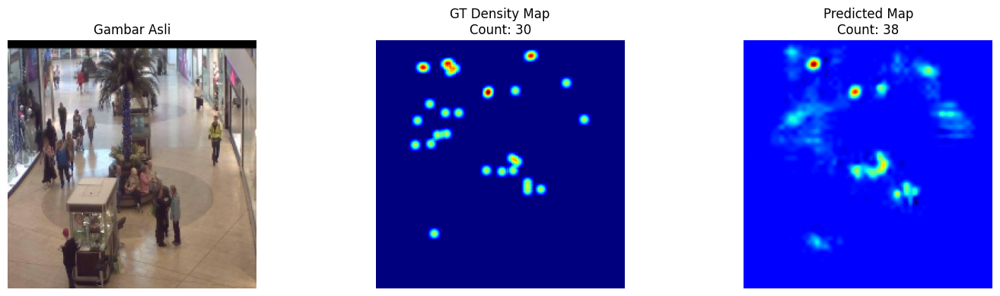

In [176]:
for i in range(len(X_batch)):
    fig, axs = plt.subplots(1, 3, figsize=(15, 4))

    axs[0].imshow(X_batch[i])
    axs[0].set_title("Gambar Asli")
    axs[0].axis("off")

    axs[1].imshow(Y_batch[i].squeeze(), cmap='jet')
    axs[1].set_title(f"GT Density Map\nCount: {Y_batch[i].sum():.0f}")
    axs[1].axis("off")

    axs[2].imshow(Y_pred[i].squeeze(), cmap='jet')
    axs[2].set_title(f"Predicted Map\nCount: {Y_pred[i].sum():.0f}")
    axs[2].axis("off")

    plt.tight_layout()
    plt.show()

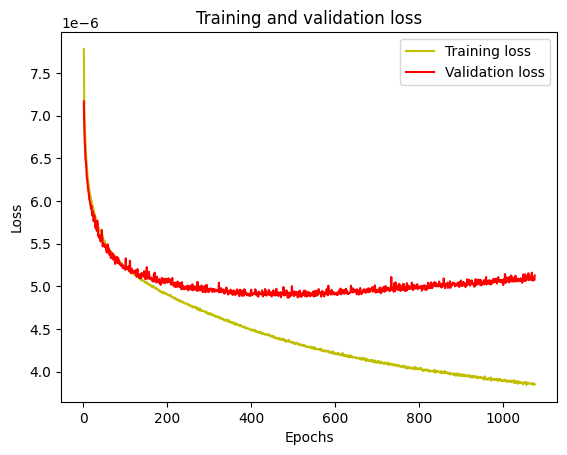

In [149]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label = 'Training loss')
plt.plot(epochs, val_loss, 'r', label = 'Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

### In the initial training phase (approximately epoch 0-50), both training and validation losses drop rapidly, showing that the model learns effectively at the start. Between epochs 50 and 200, validation loss starts to plateau while training loss continues to decrease, indicating the model is starting to fit the training data better than the validation data. After around 200 epochs, the validation loss gradually increases while training loss still decreases, suggesting the onset of overfitting. By the end of training, the widening gap between training and validation losses reflects that the model overfits the training data as training progresses.

In [150]:
model3.save("model3.h5")

## Evaluasi

In [151]:
def evaluate_mse(model, test_gen):
    mse_list = []

    for i in range(len(test_gen)):
        X_batch, Y_batch = test_gen[i]
        Y_pred = model.predict(X_batch)

        true_counts = Y_batch.sum(axis=(1, 2, 3))
        pred_counts = Y_pred.sum(axis=(1, 2, 3))

        mse = np.mean((true_counts - pred_counts) ** 2)
        mse_list.append(mse)

    return np.mean(mse_list)

In [152]:
def compute_game(model, test_gen, level=0):
    game_list = []

    for i in range(len(test_gen)):
        X_batch, Y_batch = test_gen[i]
        Y_pred = model.predict(X_batch)

        for j in range(X_batch.shape[0]):
            gt_map = Y_batch[j].squeeze()
            pred_map = Y_pred[j].squeeze()

            H, W = gt_map.shape
            H_grid = H // (2**level)
            W_grid = W // (2**level)

            error = 0.0
            for x in range(2**level):
                for y in range(2**level):
                    x1 = x * H_grid
                    y1 = y * W_grid
                    x2 = (x+1) * H_grid
                    y2 = (y+1) * W_grid

                    gt_count = gt_map[x1:x2, y1:y2].sum()
                    pred_count = pred_map[x1:x2, y1:y2].sum()

                    error += abs(gt_count - pred_count)

            game_list.append(error)

    return np.mean(game_list)

In [153]:
test_gen = CrowdDataset(test_df)

mse1 = evaluate_mse(model, test_gen)
game1 = compute_game(model, test_gen)

mse2 = evaluate_mse(mcnn_model, test_gen)
game2 = compute_game(mcnn_model, test_gen)

mse3 = evaluate_mse(model3, test_gen)
game3 = compute_game(model3, test_gen)

1/1 [==============================] - 0s 18ms/step


In [201]:
print(f"Model 1 (CSRnet):\n MSE: {mse1}\n GAME: {game1}")

Model 1 (CSRnet):
 MSE: 22.212514877319336
 GAME: 3.6627341318130493


In [178]:
print(f"Model 2 (MCNN):\n MSE: {mse2}\n GAME: {game2}")

Model 2 (MCNN):
 MSE: 8.341103553771973
 GAME: 2.117224555015564


In [179]:
print(f"Model 3 (Resnet101):\n MSE: {mse3}\n GAME: {game3}")

Model 3 (Resnet101):
 MSE: 19.002410888671875
 GAME: 3.480725359916687


Mean Squared Error (MSE)is a commonly used evaluation metric that measures the difference between the predicted count and the ground truth count. In crowd counting, the model predicts a density map for each image, and the total count is obtained by summing all the values in the predicted density map. MSE is then calculated by taking the squared difference between the predicted count and the actual count for each image, and averaging it across the entire dataset. The use of the squared error emphasizes larger mistakes, as larger errors contribute more significantly to the final MSE value. A lower MSE indicates that the model's total count predictions are closer to the actual number of people in the crowd.

To better illustrate how GAME works, consider an example where an image is divided into 4 equal grids (L=1). Suppose the ground truth count is evenly distributed, with 10 people in each grid. If the model predicts 12, 15, 9, and 8 people for each grid respectively, the absolute errors for each grid would be 2, 5, 1, and 2. The GAME is then calculated by averaging these errors across all grids, resulting in a GAME score of 2.5. This example demonstrates how GAME captures not only the global counting accuracy but also the spatial distribution accuracy of the predicted density map. Even if the total count prediction is close to the ground truth, GAME can still reflect spatial discrepancies if the model misallocates density in different regions of the image.

The evaluation results demonstrate that among the three models, MCNN consistently outperforms CSRNet and ResNet101 in both total count accuracy and spatial distribution (GAME). CSRNet produces the highest Mean Squared Error (MSE) of 22.21, indicating that it frequently mispredicts the total number of people in the image. Its Grid Average Mean Absolute Error (GAME) of 3.66 also suggests that the model struggles to accurately distribute the density map spatially, with significant errors across different grid locations. This reflects CSRNet’s tendency to overfit and its difficulty in generalizing to unseen data.

In contrast, MCNN achieves the best performance with an MSE of 8.34, representing the lowest counting error among all models. Furthermore, its GAME score of 2.12 indicates superior spatial accuracy, as it is able to localize crowd density more precisely across the image. These results show that MCNN generalizes well, remains stable during training, and exhibits minimal overfitting.

ResNet101 performs slightly better than CSRNet in terms of total count, with an MSE of 19.00, but still underperforms compared to MCNN. Its GAME score of 3.48, which is close to CSRNet's, indicates persistent spatial distribution errors. Overall, both CSRNet and ResNet101 exhibit higher sensitivity to overfitting, likely due to their heavy pretrained backbones. In contrast, MCNN's multi-scale receptive field architecture proves to be more suitable for crowd counting tasks, as it effectively handles varying object sizes and density variations within the images.

Based on the evaluation results, MCNN demonstrates superior performance compared to CSRNet and ResNet101 in this crowd counting task. MCNN achieves the lowest MSE and GAME values, indicating that it not only predicts the total number of people more accurately but also distributes the predicted density map more precisely across the spatial regions of the image. The multi-scale architecture of MCNN allows it to effectively capture variations in object sizes and crowd densities, resulting in better generalization and reduced overfitting. In contrast, CSRNet and ResNet101, which rely on heavy pretrained backbones, tend to overfit and struggle with spatial accuracy. Therefore, MCNN is considered the most optimal model for crowd counting in this data.

The superior performance of MCNN compared to CSRNet and ResNet101 can be attributed to several key factors. First, MCNN is specifically designed for crowd counting with its multi-scale architecture, where each column employs different convolutional kernel sizes. This allows the model to effectively capture variations in head sizes and crowd densities caused by perspective distortions and varying distances within the scene. In contrast, CSRNet and ResNet101 rely on pretrained backbones from object classification tasks, which may introduce irrelevant feature representations and lead to suboptimal performance in density regression tasks.

Furthermore, MCNN is trained entirely from scratch without any pretrained weights, enabling it to learn task-specific features directly from the crowd counting dataset. This prevents the model from inheriting biases from unrelated datasets such as ImageNet. Additionally, MCNN has significantly fewer parameters compared to the deeper CSRNet and ResNet101 architectures, making it less prone to overfitting and allowing better generalization, especially when working with limited training data.

## Test sample image

In [4]:
# from tensorflow.keras.models import load_model

# model = load_model("model.h5")
# mcnn_model = load_model("mcnn_model.h5")
# model3 = load_model("model3.h5")

1/1 [==============================] - 2s 2s/step
Batch 1 - Image 1
Ground Truth Count: 35.82
Model 1 (CSRnet) Count: 38.41
Model 2 (MCNN) Count: 40.56
Model 3 (ResNet) Count: 37.21


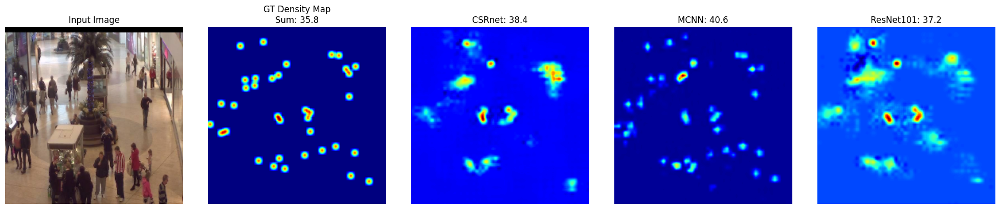

1/1 [==============================] - 0s 185ms/step
Batch 1 - Image 2
Ground Truth Count: 21.00
Model 1 (CSRnet) Count: 24.20
Model 2 (MCNN) Count: 21.65
Model 3 (ResNet) Count: 23.03


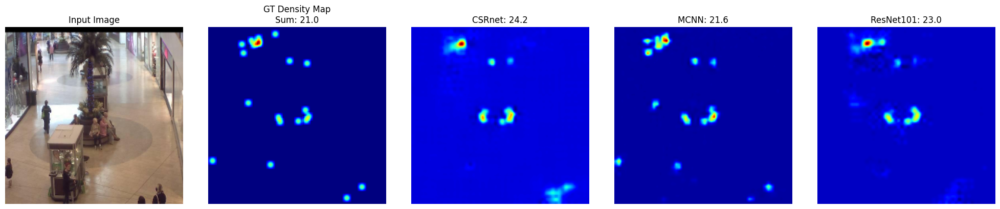

1/1 [==============================] - 0s 197ms/step
Batch 1 - Image 3
Ground Truth Count: 35.00
Model 1 (CSRnet) Count: 31.59
Model 2 (MCNN) Count: 29.02
Model 3 (ResNet) Count: 31.85


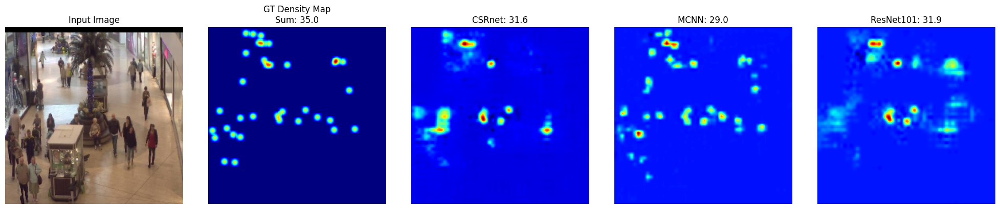

1/1 [==============================] - 0s 182ms/step
Batch 1 - Image 4
Ground Truth Count: 35.00
Model 1 (CSRnet) Count: 35.88
Model 2 (MCNN) Count: 36.03
Model 3 (ResNet) Count: 33.07


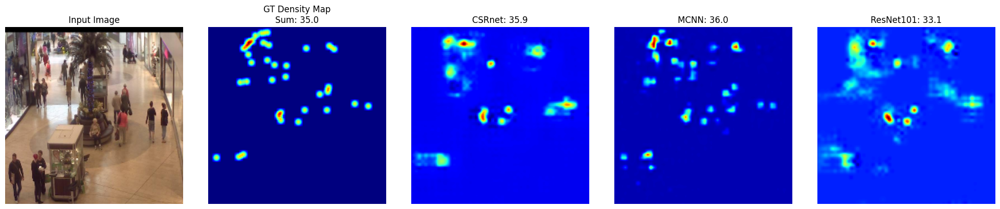

1/1 [==============================] - 0s 172ms/step
Batch 2 - Image 1
Ground Truth Count: 32.00
Model 1 (CSRnet) Count: 32.93
Model 2 (MCNN) Count: 33.19
Model 3 (ResNet) Count: 29.09


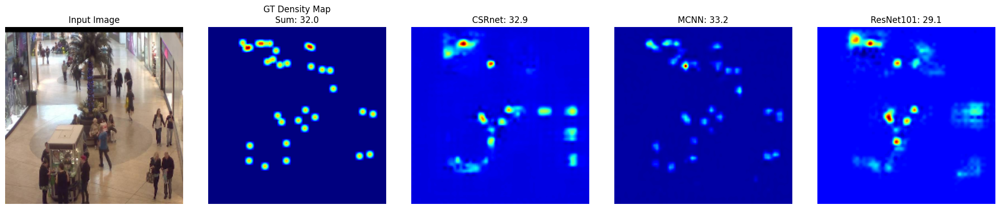

1/1 [==============================] - 0s 174ms/step
Batch 2 - Image 2
Ground Truth Count: 45.00
Model 1 (CSRnet) Count: 37.98
Model 2 (MCNN) Count: 40.48
Model 3 (ResNet) Count: 45.29


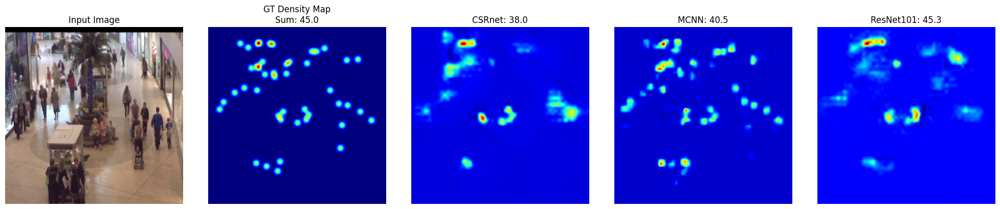

1/1 [==============================] - 0s 190ms/step
Batch 2 - Image 3
Ground Truth Count: 44.91
Model 1 (CSRnet) Count: 36.17
Model 2 (MCNN) Count: 39.21
Model 3 (ResNet) Count: 36.94


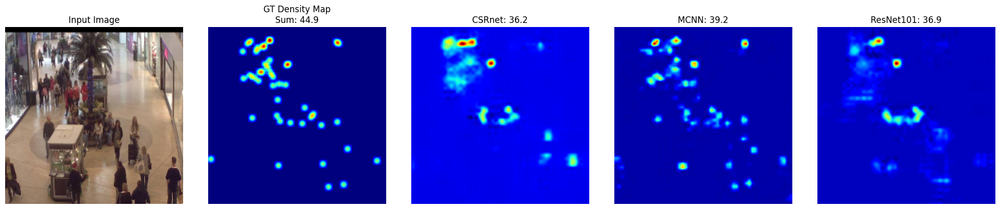

1/1 [==============================] - 0s 185ms/step
Batch 2 - Image 4
Ground Truth Count: 49.00
Model 1 (CSRnet) Count: 35.86
Model 2 (MCNN) Count: 47.17
Model 3 (ResNet) Count: 32.75


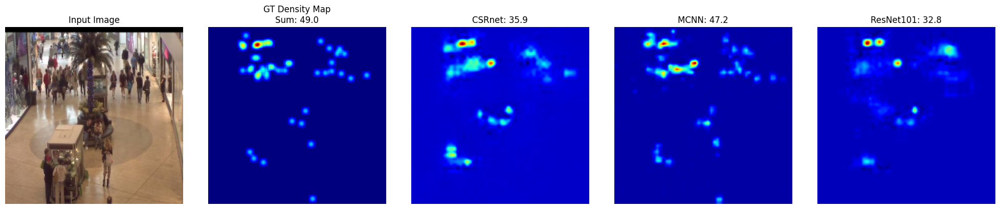

1/1 [==============================] - 0s 183ms/step
Batch 3 - Image 1
Ground Truth Count: 25.00
Model 1 (CSRnet) Count: 23.43
Model 2 (MCNN) Count: 25.20
Model 3 (ResNet) Count: 32.63


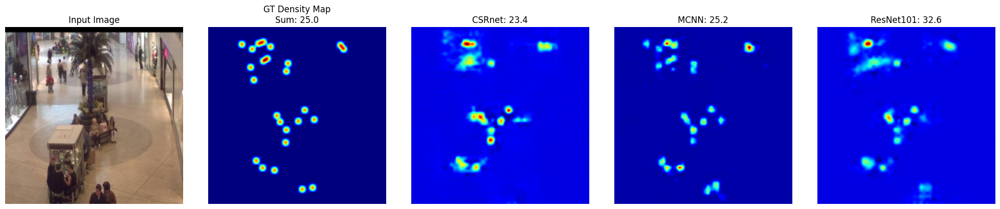

1/1 [==============================] - 0s 175ms/step
Batch 3 - Image 2
Ground Truth Count: 37.00
Model 1 (CSRnet) Count: 32.89
Model 2 (MCNN) Count: 37.71
Model 3 (ResNet) Count: 40.15


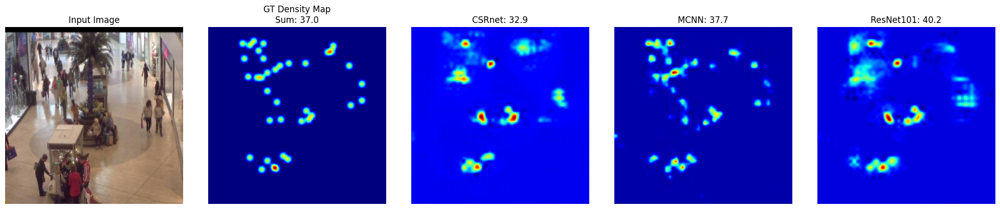

1/1 [==============================] - 0s 165ms/step
Batch 3 - Image 3
Ground Truth Count: 37.00
Model 1 (CSRnet) Count: 32.75
Model 2 (MCNN) Count: 38.38
Model 3 (ResNet) Count: 35.71


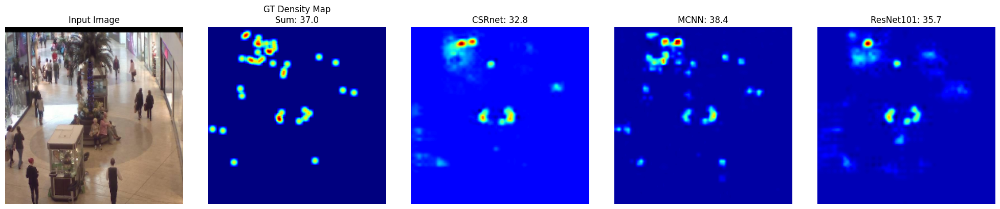

1/1 [==============================] - 0s 170ms/step
Batch 3 - Image 4
Ground Truth Count: 34.00
Model 1 (CSRnet) Count: 32.75
Model 2 (MCNN) Count: 30.65
Model 3 (ResNet) Count: 38.93


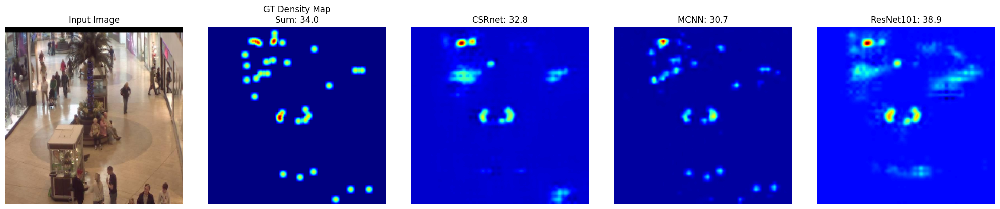

1/1 [==============================] - 0s 164ms/step
Batch 4 - Image 1
Ground Truth Count: 30.00
Model 1 (CSRnet) Count: 27.32
Model 2 (MCNN) Count: 30.96
Model 3 (ResNet) Count: 41.92


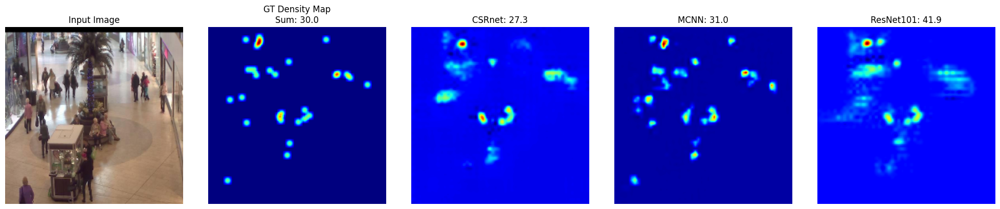

1/1 [==============================] - 0s 173ms/step
Batch 4 - Image 2
Ground Truth Count: 45.00
Model 1 (CSRnet) Count: 33.90
Model 2 (MCNN) Count: 40.97
Model 3 (ResNet) Count: 41.30


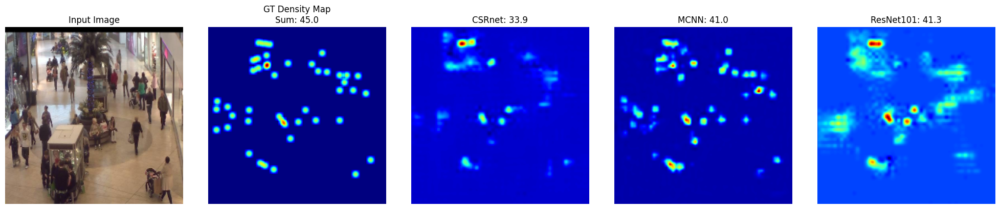

1/1 [==============================] - 0s 183ms/step
Batch 4 - Image 3
Ground Truth Count: 44.00
Model 1 (CSRnet) Count: 35.09
Model 2 (MCNN) Count: 47.68
Model 3 (ResNet) Count: 44.81


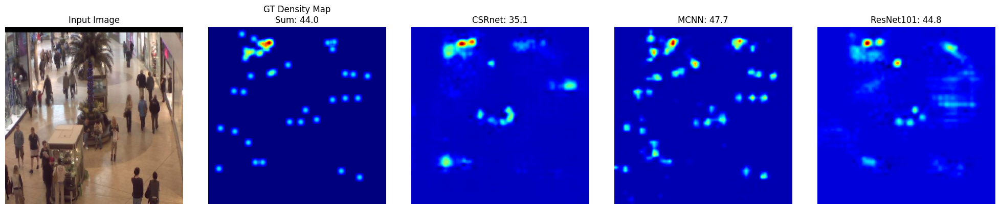

1/1 [==============================] - 0s 180ms/step
Batch 4 - Image 4
Ground Truth Count: 38.00
Model 1 (CSRnet) Count: 30.32
Model 2 (MCNN) Count: 40.28
Model 3 (ResNet) Count: 38.73


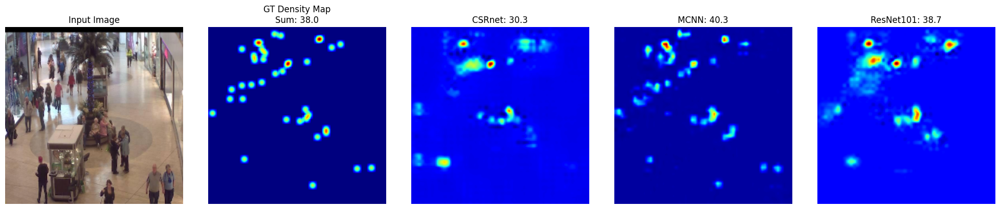

1/1 [==============================] - 0s 176ms/step
Batch 5 - Image 1
Ground Truth Count: 35.00
Model 1 (CSRnet) Count: 30.56
Model 2 (MCNN) Count: 37.26
Model 3 (ResNet) Count: 36.28


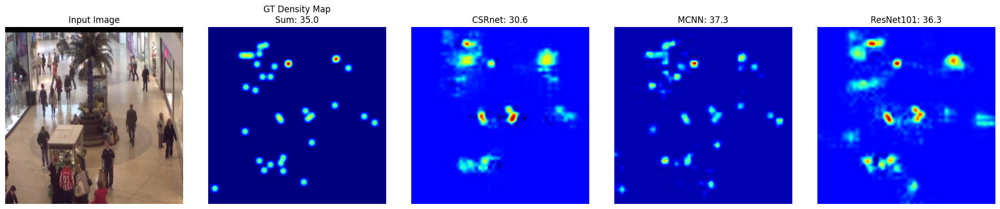

1/1 [==============================] - 0s 168ms/step
Batch 5 - Image 2
Ground Truth Count: 33.00
Model 1 (CSRnet) Count: 34.90
Model 2 (MCNN) Count: 30.95
Model 3 (ResNet) Count: 37.48


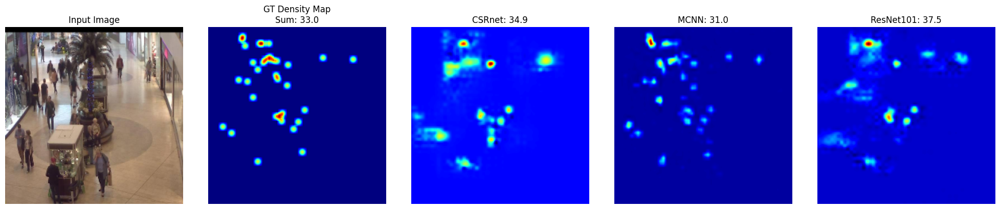

1/1 [==============================] - 0s 179ms/step
Batch 5 - Image 3
Ground Truth Count: 34.00
Model 1 (CSRnet) Count: 31.87
Model 2 (MCNN) Count: 31.94
Model 3 (ResNet) Count: 32.15


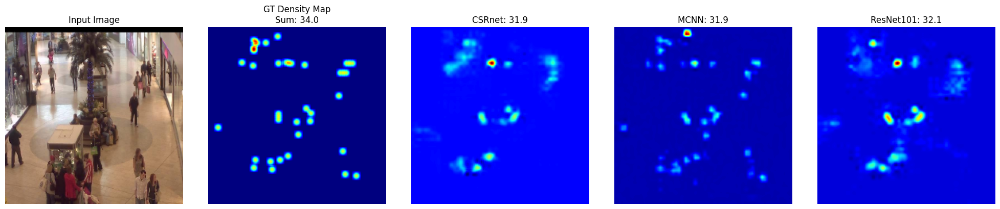

1/1 [==============================] - 0s 166ms/step
Batch 5 - Image 4
Ground Truth Count: 31.00
Model 1 (CSRnet) Count: 29.88
Model 2 (MCNN) Count: 32.21
Model 3 (ResNet) Count: 36.07


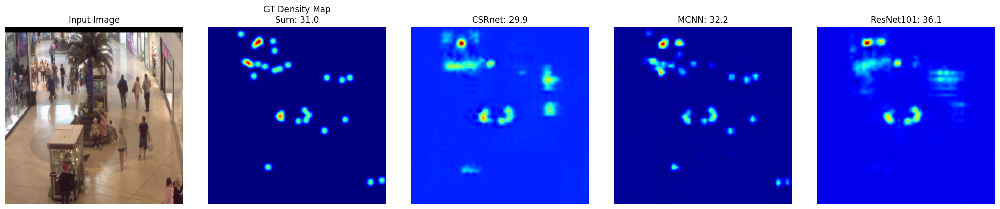

In [28]:
num_batches = 5

total_batches = len(test_gen)
num_batches = min(num_batches, total_batches)

for i in range(num_batches):
    X_batch, Y_batch = test_gen[i]
    for j in range(len(X_batch)):
        image = X_batch[j][np.newaxis, ...]
        ground_truth = Y_batch[j].sum()

        pred1 = model.predict(image)
        pred2 = mcnn_model.predict(image)
        pred3 = model3.predict(image)

        count1 = pred1.sum()
        count2 = pred2.sum()
        count3 = pred3.sum()

        print(f"Batch {i+1} - Image {j+1}")
        print(f"Ground Truth Count: {ground_truth:.2f}")
        print(f"Model 1 (CSRnet) Count: {count1:.2f}")
        print(f"Model 2 (MCNN) Count: {count2:.2f}")
        print(f"Model 3 (ResNet) Count: {count3:.2f}")

        gt_density = Y_batch[j].squeeze()
        pred1_density = pred1[0, ..., 0]
        pred2_density = pred2[0, ..., 0]
        pred3_density = pred3[0, ..., 0]

        fig, axs = plt.subplots(1, 5, figsize=(20, 4))

        axs[0].imshow(X_batch[j])
        axs[0].set_title("Input Image")
        axs[0].axis('off')

        axs[1].imshow(gt_density, cmap='jet')
        axs[1].set_title(f"GT Density Map\nSum: {ground_truth:.1f}")
        axs[1].axis('off')

        axs[2].imshow(pred1_density, cmap='jet')
        axs[2].set_title(f"CSRnet: {count1:.1f}")
        axs[2].axis('off')

        axs[3].imshow(pred2_density, cmap='jet')
        axs[3].set_title(f"MCNN: {count2:.1f}")
        axs[3].axis('off')

        axs[4].imshow(pred3_density, cmap='jet')
        axs[4].set_title(f"ResNet101: {count3:.1f}")
        axs[4].axis('off')

        plt.tight_layout()
        plt.show()

## Evaluation with different image & data

1/1 [==============================] - 0s 204ms/step


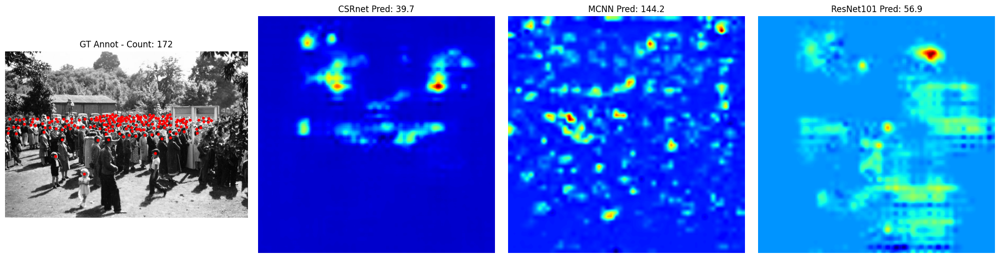

1/1 [==============================] - 0s 261ms/step


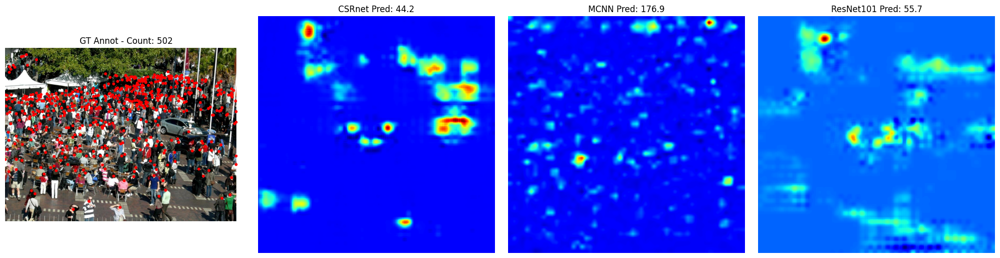

In [33]:
import scipy
samples = [
    {'img': 'IMG_1.jpg', 'mat': 'GT_IMG_1.mat'},
    {'img': 'IMG_10.jpg', 'mat': 'GT_IMG_10.mat'}
]

for sample in samples:
    img_path = sample['img']
    mat_path = sample['mat']
    
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Resize untuk model input (224x224)
    img_resized = cv2.resize(img, (224, 224))
    img_resized = img_resized / 255.0
    img_resized = img_resized[np.newaxis, ...]
    
    mat = scipy.io.loadmat(mat_path)
    annPoints = mat['image_info'][0][0][0][0][0]
    gt_count = len(annPoints)
    
    # Predict semua model
    pred1 = model.predict(img_resized)
    pred2 = mcnn_model.predict(img_resized)
    pred3 = model3.predict(img_resized)
    
    count1 = pred1.sum()
    count2 = pred2.sum()
    count3 = pred3.sum()
    
    plt.figure(figsize=(20, 5))

    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.scatter(annPoints[:, 0], annPoints[:, 1], s=10, c='red')
    plt.title(f"GT Annot - Count: {gt_count}")
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(pred1[0, ..., 0], cmap='jet')
    plt.title(f"CSRnet Pred: {count1:.1f}")
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.imshow(pred2[0, ..., 0], cmap='jet')
    plt.title(f"MCNN Pred: {count2:.1f}")
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(pred3[0, ..., 0], cmap='jet')
    plt.title(f"ResNet101 Pred: {count3:.1f}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

When tested on a different dataset, MCNN demonstrates better transferability and robustness. When tested on new datasets due to its multi-scale architecture, task-specific learning from scratch, and lower model complexity that allows better generalization. In contrast, CSRNet and ResNet101, which heavily rely on pretrained features from object classification, struggle to adapt to new crowd distributions and density variations, resulting in significant prediction errors on unseen datasets.